<a href="https://colab.research.google.com/github/nounou-mimi/CROP-DISEASE-CODE/blob/main/detection/TomatoDiseaseDetection_Faster_R_CNN_fromScratch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


#Imports

In [ ]:
%cd /content/gdrive/MyDrive/copy_tomato_disease_detection/

/content/gdrive/MyDrive/copy_tomato_disease_detection


In [ ]:
!pip install tensorflow==1.15.0
!pip install Keras==2.2.5


In [ ]:
!pip install 'h5py<3.0.0'

In [ ]:
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
import random
import pprint
import sys
import time
import numpy as np
from optparse import OptionParser
import pickle
import math
import cv2
import copy
from matplotlib import pyplot as plt
import tensorflow as tf
import pandas as pd
import os

from sklearn.metrics import average_precision_score

from keras import backend as K
from keras.optimizers import Adam, SGD, RMSprop
from keras.layers import Flatten, Dense, Input, Conv2D, MaxPooling2D, Dropout
from keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, TimeDistributed
from keras.engine.topology import get_source_inputs
from keras.utils import layer_utils
from keras.utils.data_utils import get_file
from keras.objectives import categorical_crossentropy

from keras.models import Model
from keras.utils import generic_utils
from keras.engine import Layer, InputSpec
from keras import initializers, regularizers

#EDA


##DataFrame

In [ ]:
%cd /content/gdrive/MyDrive/tomato_disease_detection/

/content/gdrive/MyDrive/tomato_disease_detection


In [ ]:
train=pd.read_csv('annotation.csv')

In [ ]:
train.head()

,Unnamed: 0,filename,xmin,xmax,ymin,ymax,class_name
0,0,4fb6720b-508c-49cc-b3e0-81656128bf59___YLCV_GC...,10,246,10,246,Tomato___Yellow_Leaf_Curl_Virus
1,1,8db2385b-edb8-46c1-92ab-c46bf76db8be___Com.G_S...,10,246,10,246,Tomato___Spider_mites
2,2,d3cc7383-40d6-490c-9cd7-a089f462ff54___RS_Late...,10,246,10,246,Tomato___Late_blight
3,3,955d6942-0e13-4221-b349-266e5ae9cc56___GCREC_B...,10,246,10,246,Tomato___Bacterial_spot
4,4,86655e14-c482-44f2-8576-f0b510dd0273___YLCV_NR...,10,246,10,246,Tomato___Yellow_Leaf_Curl_Virus


In [ ]:
train.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
test=pd.read_csv('test.csv')

##Some Data Exploration and Viz to check


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches

In [ ]:
%cd /content/gdrive/MyDrive/tomato_disease_detection/

/content/gdrive/MyDrive/tomato_disease_detection


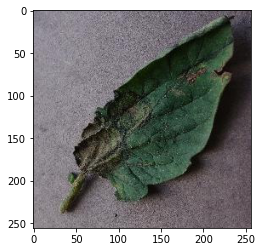

In [ ]:
# reading single image using imread function of matplotlib
image = plt.imread('TomatoData/'+ train['filename'].iloc[2])
plt.imshow(image)

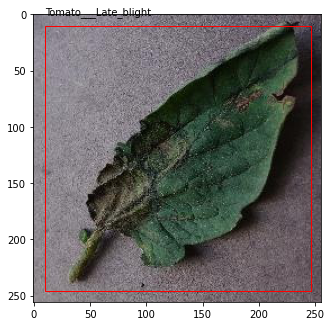

In [ ]:
fig = plt.figure()

#add axes to the image
ax = fig.add_axes([0,0,1,1])

# read and plot the image
image = plt.imread('TomatoData/'+ train['filename'].iloc[2])
plt.imshow(image)

# iterating over the image for different objects
for i,row in train[train.filename==train['filename'].iloc[2]].iterrows():
    xmin = row.xmin
    xmax = row.xmax
    ymin = row.ymin
    ymax = row.ymax
    
    width = xmax - xmin
    height = ymax - ymin
        
    # add bounding boxes to the image
    rect = patches.Rectangle((xmin,ymin), width, height, facecolor=None,fill=False,label=row['class_name'], color='r')
    
    ax.add_patch(rect)
    ax.text(xmin,ymin-10,row['class_name'])

#Model

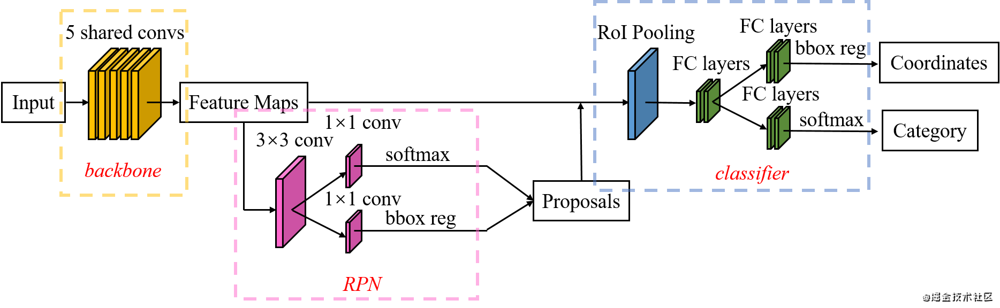

 
source of the image : https://cdmana.com/2021/06/20210621203629238y.html


##Essential Bricks 

#### Config class

In [ ]:
class Config:

	def __init__(self):

		# Print the process or not
		self.verbose = True

		# Name of base network
		self.network = 'vgg'

		# Setting for data augmentation
		self.use_horizontal_flips = False
		self.use_vertical_flips = False
		self.rot_90 = False

		# Anchor box scales
    # Note that if im_size is smaller, anchor_box_scales should be scaled
    # Original anchor_box_scales in the paper is [128, 256, 512]
		self.anchor_box_scales = [64, 128, 256] 

		# Anchor box ratios
		self.anchor_box_ratios = [[1, 1], [1./math.sqrt(2), 2./math.sqrt(2)], [2./math.sqrt(2), 1./math.sqrt(2)]]

		# Size to resize the smallest side of the image
		# Original setting in paper is 600. Set to 300 in here to save training time
		self.im_size = 300

		# image channel-wise mean to subtract
		self.img_channel_mean = [103.939, 116.779, 123.68]
		self.img_scaling_factor = 1.0

		# number of ROIs at once
		self.num_rois = 4

		# stride at the RPN (this depends on the network configuration)
		self.rpn_stride = 16

		self.balanced_classes = False

		# scaling the stdev
		self.std_scaling = 4.0
		self.classifier_regr_std = [8.0, 8.0, 4.0, 4.0]

		# overlaps for RPN
		self.rpn_min_overlap = 0.3
		self.rpn_max_overlap = 0.7

		# overlaps for classifier ROIs
		self.classifier_min_overlap = 0.1
		self.classifier_max_overlap = 0.5

		# placeholder for the class mapping, automatically generated by the parser
		self.class_mapping = None

		self.model_path = None

#### Parser to parse the data from annotation file

In [ ]:
import re
# Parser the data from annotation file
def get_data(input_path):
	"""Parse the data from annotation file
	
	Args:
		input_path: annotation file path

	Returns:
		all_data: list(filepath, width, height, list(bboxes))
		classes_count: dict{key:class_name, value:count_num} 
			e.g. {'Car': 2383, 'Mobile phone': 1108, 'Person': 3745}
		class_mapping: dict{key:class_name, value: idx}
			e.g. {'Car': 0, 'Mobile phone': 1, 'Person': 2}
	"""
	found_bg = False
	all_imgs = {}

	classes_count = {}

	class_mapping = {}

	visualise = True

	i = 1
	
	with open(input_path,'r') as f:

		print('Parsing annotation files')

		for line in f:

			# Print process
			sys.stdout.write('\r'+'idx=' + str(i))
			i += 1
			
			clean_line=line.strip().replace('"','')
			if (re.match(r'\/content\/gdrive\/MyDrive\/copy_tomato_disease_detection\/train_data\/[^,]+?((\.jpg)+|(\.png)+|(\.JPG)+).+',clean_line)  or re.match(r'\/content\/gdrive\/MyDrive\/copy_tomato_disease_detection\/test_data\/[^,]+?((\.jpg)+|(\.png)+|(\.JPG)+).+',clean_line))  and (cv2.imread(clean_line.split(',')[0])) is not None:
				line_split = clean_line.split(',')
				(filename,x1,y1,x2,y2,class_name) = tuple(line_split)
			elif (cv2.imread(clean_line.replace(',','').split(',')[0]) is not None) :
				line_split=clean_line.replace(',','').split(',')
				(filename,x1,y1,x2,y2,class_name) = tuple(line_split)
			elif (cv2.imread((',').join(clean_line.split(',')[:-7])) is not None):
				line_split=clean_line.split(',')
				(filename,x1,y1,x2,y2,class_name)=(',').join(line_split[:-7]),*line_split[-7:]
			else:
				continue 

			if class_name not in classes_count:
				classes_count[class_name] = 1
			else:
				classes_count[class_name] += 1

			if class_name not in class_mapping:
				if class_name == 'bg' and found_bg == False:
					print('Found class name with special name bg. Will be treated as a background region (this is usually for hard negative mining).')
					found_bg = True
				class_mapping[class_name] = len(class_mapping)

			if filename not in all_imgs:
				all_imgs[filename] = {}
				
				img = cv2.imread(filename)
				(rows,cols) = img.shape[:2]
				all_imgs[filename]['filepath'] = filename
				all_imgs[filename]['width'] = cols
				all_imgs[filename]['height'] = rows
				all_imgs[filename]['bboxes'] = []
				
			all_imgs[filename]['bboxes'].append({'class': class_name, 'x1': int(x1), 'x2': int(x2), 'y1': int(y1), 'y2': int(y2)})


		all_data = []
		for key in all_imgs:
			all_data.append(all_imgs[key])
		
		# make sure the bg class is last in the list
		if found_bg:
			if class_mapping['bg'] != len(class_mapping) - 1:
				key_to_switch = [key for key in class_mapping.keys() if class_mapping[key] == len(class_mapping)-1][0]
				val_to_switch = class_mapping['bg']
				class_mapping['bg'] = len(class_mapping) - 1
				class_mapping[key_to_switch] = val_to_switch
		
		return all_data, classes_count, class_mapping

####ROI Pooling Conv Layer (Class)

In [ ]:
#Define ROI Pooling Convolutional Layer

class RoiPoolingConv(Layer):
    '''ROI pooling layer for 2D inputs.
    See Spatial Pyramid Pooling in Deep Convolutional Networks for Visual Recognition,
    K. He, X. Zhang, S. Ren, J. Sun
    # Arguments
        pool_size: int
            Size of pooling region to use. pool_size = 7 will result in a 7x7 region.
        num_rois: number of regions of interest to be used
    # Input shape
        list of two 4D tensors [X_img,X_roi] with shape:
        X_img:
        `(1, rows, cols, channels)`
        X_roi:
        `(1,num_rois,4)` list of rois, with ordering (x,y,w,h)
    # Output shape
        3D tensor with shape:
        `(1, num_rois, channels, pool_size, pool_size)`
    '''
    def __init__(self, pool_size, num_rois, **kwargs):

        self.dim_ordering = K.image_data_format()
        self.pool_size = pool_size
        self.num_rois = num_rois

        super(RoiPoolingConv, self).__init__(**kwargs)

    def build(self, input_shape):
        self.nb_channels = input_shape[0][3]   

    def compute_output_shape(self, input_shape):
        return None, self.num_rois, self.pool_size, self.pool_size, self.nb_channels

    def call(self, x, mask=None):

        assert(len(x) == 2)

        # x[0] is image with shape (rows, cols, channels)
        img = x[0]

        # x[1] is roi with shape (num_rois,4) with ordering (x,y,w,h)
        rois = x[1]

        input_shape = K.shape(img)

        outputs = []

        for roi_idx in range(self.num_rois):

            x = rois[0, roi_idx, 0]
            y = rois[0, roi_idx, 1]
            w = rois[0, roi_idx, 2]
            h = rois[0, roi_idx, 3]

            x = K.cast(x, 'int32')
            y = K.cast(y, 'int32')
            w = K.cast(w, 'int32')
            h = K.cast(h, 'int32')

            # Resized roi of the image to pooling size (7x7)
            rs = tf.image.resize(img[:, y:y+h, x:x+w, :], (self.pool_size, self.pool_size))
            outputs.append(rs)
                

        final_output = K.concatenate(outputs, axis=0)

        # Reshape to (1, num_rois, pool_size, pool_size, nb_channels)
        # Might be (1, 4, 7, 7, 3)
        final_output = K.reshape(final_output, (1, self.num_rois, self.pool_size, self.pool_size, self.nb_channels))

        # permute_dimensions is similar to transpose
        final_output = K.permute_dimensions(final_output, (0, 1, 2, 3, 4))

        return final_output
    
    
    def get_config(self):
        config = {'pool_size': self.pool_size,
                  'num_rois': self.num_rois}
        base_config = super(RoiPoolingConv, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

####1/ Base Network (VGG)

In [ ]:
# VGG-16 (BAse Network)

def get_img_output_length(width, height):
    def get_output_length(input_length):
        return input_length//16

    return get_output_length(width), get_output_length(height)    

def nn_base(input_tensor=None, trainable=False):


    input_shape = (None, None, 3)

    if input_tensor is None:
        img_input = Input(shape=input_shape)
    else:
        if not K.is_keras_tensor(input_tensor):
            img_input = Input(tensor=input_tensor, shape=input_shape)
        else:
            img_input = input_tensor

    bn_axis = 3
    
    # Block 1
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1')(img_input)
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool')(x)

    # Block 2
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1')(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool')(x)
    
    # Block 3
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool')(x)

    # Block 4
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool')(x)

    # Block 5
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3')(x)
    # x = MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool')(x)

    return x

####2/ RPN Layer

In [ ]:
#RPN layer

def rpn_layer(base_layers, num_anchors):
    """Create a rpn layer
        Step1: Pass through the feature map from base layer to a 3x3 512 channels convolutional layer
                Keep the padding 'same' to preserve the feature map's size
        Step2: Pass the step1 to two (1,1) convolutional layer to replace the fully connected layer
                classification layer: num_anchors (9 in here) channels for 0, 1 sigmoid activation output
                regression layer: num_anchors*4 (36 in here) channels for computing the regression of bboxes with linear activation
    Args:
        base_layers: vgg in here
        num_anchors: 9 in here

    Returns:
        [x_class, x_regr, base_layers]
        x_class: classification for whether it's an object
        x_regr: bboxes regression
        base_layers: vgg in here
    """
    x = Conv2D(512, (3, 3), padding='same', activation='relu', kernel_initializer='normal', name='rpn_conv1')(base_layers)

    x_class = Conv2D(num_anchors, (1, 1), activation='sigmoid', kernel_initializer='uniform', name='rpn_out_class')(x)
    x_regr = Conv2D(num_anchors * 4, (1, 1), activation='linear', kernel_initializer='zero', name='rpn_out_regress')(x)

    return [x_class, x_regr, base_layers]

####3/ Classifier Layer

In [ ]:
#Classifier layer

def classifier_layer(base_layers, input_rois, num_rois, nb_classes = 30):
    

    input_shape = (num_rois,7,7,512)

    pooling_regions = 7

    # out_roi_pool.shape = (1, num_rois, channels, pool_size, pool_size)
    # num_rois (4) 7x7 roi pooling
    out_roi_pool = RoiPoolingConv(pooling_regions, num_rois)([base_layers, input_rois])

    # Flatten the convlutional layer and connected to 2 FC and 2 dropout
    out = TimeDistributed(Flatten(name='flatten'))(out_roi_pool)
    out = TimeDistributed(Dense(4096, activation='relu', name='fc1'))(out)
    out = TimeDistributed(Dropout(0.5))(out)
    out = TimeDistributed(Dense(4096, activation='relu', name='fc2'))(out)
    out = TimeDistributed(Dropout(0.5))(out)

    # There are two output layer
    # out_class: softmax acivation function for classify the class name of the object
    # out_regr: linear activation function for bboxes coordinates regression
    out_class = TimeDistributed(Dense(nb_classes, activation='softmax', kernel_initializer='zero'), name='dense_class_{}'.format(nb_classes))(out)
    # note: no regression target for bg class
    out_regr = TimeDistributed(Dense(4 * (nb_classes-1), activation='linear', kernel_initializer='zero'), name='dense_regress_{}'.format(nb_classes))(out)

    return [out_class, out_regr]

#### Function to calculate IoU

In [ ]:
#Calculate IoU (Intersection over Union)

def union(au, bu, area_intersection):
	area_a = (au[2] - au[0]) * (au[3] - au[1])
	area_b = (bu[2] - bu[0]) * (bu[3] - bu[1])
	area_union = area_a + area_b - area_intersection
	return area_union


def intersection(ai, bi):
	x = max(ai[0], bi[0])
	y = max(ai[1], bi[1])
	w = min(ai[2], bi[2]) - x
	h = min(ai[3], bi[3]) - y
	if w < 0 or h < 0:
		return 0
	return w*h


def iou(a, b):
	# a and b should be (x1,y1,x2,y2)

	if a[0] >= a[2] or a[1] >= a[3] or b[0] >= b[2] or b[1] >= b[3]:
		return 0.0

	area_i = intersection(a, b)
	area_u = union(a, b, area_i)

	return float(area_i) / float(area_u + 1e-6)

#### Calculate the RPN for all anchors of all images

In [ ]:
#Calculate the rpn for all anchors of all images

def calc_rpn(C, img_data, width, height, resized_width, resized_height, img_length_calc_function):
	
	downscale = float(C.rpn_stride) 
	anchor_sizes = C.anchor_box_scales   # 128, 256, 512
	anchor_ratios = C.anchor_box_ratios  # 1:1, 1:2*sqrt(2), 2*sqrt(2):1
	num_anchors = len(anchor_sizes) * len(anchor_ratios) # 3x3=9

	# calculate the output map size based on the network architecture
	(output_width, output_height) = img_length_calc_function(resized_width, resized_height)

	n_anchratios = len(anchor_ratios)    # 3
	
	# initialise empty output objectives
	y_rpn_overlap = np.zeros((output_height, output_width, num_anchors))
	y_is_box_valid = np.zeros((output_height, output_width, num_anchors))
	y_rpn_regr = np.zeros((output_height, output_width, num_anchors * 4))

	num_bboxes = len(img_data['bboxes'])

	num_anchors_for_bbox = np.zeros(num_bboxes).astype(int)
	best_anchor_for_bbox = -1*np.ones((num_bboxes, 4)).astype(int)
	best_iou_for_bbox = np.zeros(num_bboxes).astype(np.float32)
	best_x_for_bbox = np.zeros((num_bboxes, 4)).astype(int)
	best_dx_for_bbox = np.zeros((num_bboxes, 4)).astype(np.float32)

	# get the GT box coordinates, and resize to account for image resizing
	gta = np.zeros((num_bboxes, 4))
	for bbox_num, bbox in enumerate(img_data['bboxes']):
		# get the GT box coordinates, and resize to account for image resizing
		gta[bbox_num, 0] = bbox['x1'] * (resized_width / float(width))
		gta[bbox_num, 1] = bbox['x2'] * (resized_width / float(width))
		gta[bbox_num, 2] = bbox['y1'] * (resized_height / float(height))
		gta[bbox_num, 3] = bbox['y2'] * (resized_height / float(height))
	
	# rpn ground truth

	for anchor_size_idx in range(len(anchor_sizes)):
		for anchor_ratio_idx in range(n_anchratios):
			anchor_x = anchor_sizes[anchor_size_idx] * anchor_ratios[anchor_ratio_idx][0]
			anchor_y = anchor_sizes[anchor_size_idx] * anchor_ratios[anchor_ratio_idx][1]	
			
			for ix in range(output_width):					
				# x-coordinates of the current anchor box	
				x1_anc = downscale * (ix + 0.5) - anchor_x / 2
				x2_anc = downscale * (ix + 0.5) + anchor_x / 2	
				
				# ignore boxes that go across image boundaries					
				if x1_anc < 0 or x2_anc > resized_width:
					continue
					
				for jy in range(output_height):

					# y-coordinates of the current anchor box
					y1_anc = downscale * (jy + 0.5) - anchor_y / 2
					y2_anc = downscale * (jy + 0.5) + anchor_y / 2

					# ignore boxes that go across image boundaries
					if y1_anc < 0 or y2_anc > resized_height:
						continue

					# bbox_type indicates whether an anchor should be a target
					# Initialize with 'negative'
					bbox_type = 'neg'

					# this is the best IOU for the (x,y) coord and the current anchor
					# note that this is different from the best IOU for a GT bbox
					best_iou_for_loc = 0.0

					for bbox_num in range(num_bboxes):
						
						# get IOU of the current GT box and the current anchor box
						curr_iou = iou([gta[bbox_num, 0], gta[bbox_num, 2], gta[bbox_num, 1], gta[bbox_num, 3]], [x1_anc, y1_anc, x2_anc, y2_anc])
						# calculate the regression targets if they will be needed
						if curr_iou > best_iou_for_bbox[bbox_num] or curr_iou > C.rpn_max_overlap:
							cx = (gta[bbox_num, 0] + gta[bbox_num, 1]) / 2.0
							cy = (gta[bbox_num, 2] + gta[bbox_num, 3]) / 2.0
							cxa = (x1_anc + x2_anc)/2.0
							cya = (y1_anc + y2_anc)/2.0

							tx = (cx - cxa) / (x2_anc - x1_anc)
							ty = (cy - cya) / (y2_anc - y1_anc)
							tw = np.log((gta[bbox_num, 1] - gta[bbox_num, 0]) / (x2_anc - x1_anc))
							th = np.log((gta[bbox_num, 3] - gta[bbox_num, 2]) / (y2_anc - y1_anc))
						
						if img_data['bboxes'][bbox_num]['class'] != 'bg':

							# all GT boxes should be mapped to an anchor box, so we keep track of which anchor box was best
							if curr_iou > best_iou_for_bbox[bbox_num]:
								best_anchor_for_bbox[bbox_num] = [jy, ix, anchor_ratio_idx, anchor_size_idx]
								best_iou_for_bbox[bbox_num] = curr_iou
								best_x_for_bbox[bbox_num,:] = [x1_anc, x2_anc, y1_anc, y2_anc]
								best_dx_for_bbox[bbox_num,:] = [tx, ty, tw, th]

							# we set the anchor to positive if the IOU is >0.7 (it does not matter if there was another better box, it just indicates overlap)
							if curr_iou > C.rpn_max_overlap:
								bbox_type = 'pos'
								num_anchors_for_bbox[bbox_num] += 1
								# we update the regression layer target if this IOU is the best for the current (x,y) and anchor position
								if curr_iou > best_iou_for_loc:
									best_iou_for_loc = curr_iou
									best_regr = (tx, ty, tw, th)

							# if the IOU is >0.3 and <0.7, it is ambiguous and no included in the objective
							if C.rpn_min_overlap < curr_iou < C.rpn_max_overlap:
								# gray zone between neg and pos
								if bbox_type != 'pos':
									bbox_type = 'neutral'

					# turn on or off outputs depending on IOUs
					if bbox_type == 'neg':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
					elif bbox_type == 'neutral':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 0
					elif bbox_type == 'pos':
						y_is_box_valid[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						y_rpn_overlap[jy, ix, anchor_ratio_idx + n_anchratios * anchor_size_idx] = 1
						start = 4 * (anchor_ratio_idx + n_anchratios * anchor_size_idx)
						y_rpn_regr[jy, ix, start:start+4] = best_regr

	# we ensure that every bbox has at least one positive RPN region

	for idx in range(num_anchors_for_bbox.shape[0]):
		if num_anchors_for_bbox[idx] == 0:
			# no box with an IOU greater than zero ...
			if best_anchor_for_bbox[idx, 0] == -1:
				continue
			y_is_box_valid[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], best_anchor_for_bbox[idx,2] + n_anchratios *
				best_anchor_for_bbox[idx,3]] = 1
			y_rpn_overlap[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], best_anchor_for_bbox[idx,2] + n_anchratios *
				best_anchor_for_bbox[idx,3]] = 1
			start = 4 * (best_anchor_for_bbox[idx,2] + n_anchratios * best_anchor_for_bbox[idx,3])
			y_rpn_regr[
				best_anchor_for_bbox[idx,0], best_anchor_for_bbox[idx,1], start:start+4] = best_dx_for_bbox[idx, :]

	y_rpn_overlap = np.transpose(y_rpn_overlap, (2, 0, 1))
	y_rpn_overlap = np.expand_dims(y_rpn_overlap, axis=0)

	y_is_box_valid = np.transpose(y_is_box_valid, (2, 0, 1))
	y_is_box_valid = np.expand_dims(y_is_box_valid, axis=0)

	y_rpn_regr = np.transpose(y_rpn_regr, (2, 0, 1))
	y_rpn_regr = np.expand_dims(y_rpn_regr, axis=0)

	pos_locs = np.where(np.logical_and(y_rpn_overlap[0, :, :, :] == 1, y_is_box_valid[0, :, :, :] == 1))
	neg_locs = np.where(np.logical_and(y_rpn_overlap[0, :, :, :] == 0, y_is_box_valid[0, :, :, :] == 1))

	num_pos = len(pos_locs[0])

	# one issue is that the RPN has many more negative than positive regions, so we turn off some of the negative
	# regions. We also limit it to 256 regions.
	num_regions = 256

	if len(pos_locs[0]) > num_regions/2:
		val_locs = random.sample(range(len(pos_locs[0])), len(pos_locs[0]) - num_regions/2)
		y_is_box_valid[0, pos_locs[0][val_locs], pos_locs[1][val_locs], pos_locs[2][val_locs]] = 0
		num_pos = num_regions/2

	if len(neg_locs[0]) + num_pos > num_regions:
		val_locs = random.sample(range(len(neg_locs[0])), len(neg_locs[0]) - num_pos)
		y_is_box_valid[0, neg_locs[0][val_locs], neg_locs[1][val_locs], neg_locs[2][val_locs]] = 0

	y_rpn_cls = np.concatenate([y_is_box_valid, y_rpn_overlap], axis=1)
	y_rpn_regr = np.concatenate([np.repeat(y_rpn_overlap, 4, axis=1), y_rpn_regr], axis=1)

	return np.copy(y_rpn_cls), np.copy(y_rpn_regr), num_pos

#### Function to augment the data

In [ ]:
#Get new image size and augment the image

def get_new_img_size(width, height, img_min_side=416):
	if width <= height:
		f = float(img_min_side) / width
		resized_height = int(f * height)
		resized_width = img_min_side
	else:
		f = float(img_min_side) / height
		resized_width = int(f * width)
		resized_height = img_min_side

	return resized_width, resized_height

def augment(img_data, config, augment=True):
	assert 'filepath' in img_data
	assert 'bboxes' in img_data
	assert 'width' in img_data
	assert 'height' in img_data

	img_data_aug = copy.deepcopy(img_data)
	img = cv2.imread(img_data_aug['filepath'])

	if augment:
		rows, cols = img.shape[:2]

		if config.use_horizontal_flips and np.random.randint(0, 2) == 0:
			img = cv2.flip(img, 1)
			for bbox in img_data_aug['bboxes']:
				x1 = bbox['x1']
				x2 = bbox['x2']
				bbox['x2'] = cols - x1
				bbox['x1'] = cols - x2

		if config.use_vertical_flips and np.random.randint(0, 2) == 0:
			img = cv2.flip(img, 0)
			for bbox in img_data_aug['bboxes']:
				y1 = bbox['y1']
				y2 = bbox['y2']
				bbox['y2'] = rows - y1
				bbox['y1'] = rows - y2

		if config.rot_90:
			angle = np.random.choice([0,90,180,270],1)[0]
			if angle == 270:
				img = np.transpose(img, (1,0,2))
				img = cv2.flip(img, 0)
			elif angle == 180:
				img = cv2.flip(img, -1)
			elif angle == 90:
				img = np.transpose(img, (1,0,2))
				img = cv2.flip(img, 1)
			elif angle == 0:
				pass

			for bbox in img_data_aug['bboxes']:
				x1 = bbox['x1']
				x2 = bbox['x2']
				y1 = bbox['y1']
				y2 = bbox['y2']
				if angle == 270:
					bbox['x1'] = y1
					bbox['x2'] = y2
					bbox['y1'] = cols - x2
					bbox['y2'] = cols - x1
				elif angle == 180:
					bbox['x2'] = cols - x1
					bbox['x1'] = cols - x2
					bbox['y2'] = rows - y1
					bbox['y1'] = rows - y2
				elif angle == 90:
					bbox['x1'] = rows - y2
					bbox['x2'] = rows - y1
					bbox['y1'] = x1
					bbox['y2'] = x2        
				elif angle == 0:
					pass

	img_data_aug['width'] = img.shape[1]
	img_data_aug['height'] = img.shape[0]

	return img_data_aug, img


#### Generate the ground truth anchors

In [ ]:
#Generate the ground_truth anchors

def get_anchor_gt(all_img_data, C, img_length_calc_function, mode='train'):
	""" Yield the ground-truth anchors as Y (labels)
		
	Args:
		all_img_data: list(filepath, width, height, list(bboxes))
		C: config
		img_length_calc_function: function to calculate final layer's feature map (of base model) size according to input image size
		mode: 'train' or 'test'; 'train' mode need augmentation

	Returns:
		x_img: image data after resized and scaling (smallest size = 416px)
		Y: [y_rpn_cls, y_rpn_regr]
		img_data_aug: augmented image data (original image with augmentation)
		debug_img: show image for debug
		num_pos: show number of positive anchors for debug
	"""
	while True:

		for img_data in all_img_data:
			try:

				# read in image, and optionally add augmentation

				if mode == 'train':
					img_data_aug, x_img = augment(img_data, C, augment=True)
				else:
					img_data_aug, x_img = augment(img_data, C, augment=False)

				(width, height) = (img_data_aug['width'], img_data_aug['height'])
				(rows, cols, _) = x_img.shape

				assert cols == width
				assert rows == height

				# get image dimensions for resizing
				(resized_width, resized_height) = get_new_img_size(width, height, C.im_size)

				# resize the image so that smalles side is length = 300px
				x_img = cv2.resize(x_img, (resized_width, resized_height), interpolation=cv2.INTER_CUBIC)
				debug_img = x_img.copy()

				try:
					y_rpn_cls, y_rpn_regr, num_pos = calc_rpn(C, img_data_aug, width, height, resized_width, resized_height, img_length_calc_function)
				except:
					continue

				# Zero-center by mean pixel, and preprocess image

				x_img = x_img[:,:, (2, 1, 0)]  # BGR -> RGB
				x_img = x_img.astype(np.float32)
				x_img[:, :, 0] -= C.img_channel_mean[0]
				x_img[:, :, 1] -= C.img_channel_mean[1]
				x_img[:, :, 2] -= C.img_channel_mean[2]
				x_img /= C.img_scaling_factor

				x_img = np.transpose(x_img, (2, 0, 1))
				x_img = np.expand_dims(x_img, axis=0)

				y_rpn_regr[:, y_rpn_regr.shape[1]//2:, :, :] *= C.std_scaling

				x_img = np.transpose(x_img, (0, 2, 3, 1))
				y_rpn_cls = np.transpose(y_rpn_cls, (0, 2, 3, 1))
				y_rpn_regr = np.transpose(y_rpn_regr, (0, 2, 3, 1))

				yield np.copy(x_img), [np.copy(y_rpn_cls), np.copy(y_rpn_regr)], img_data_aug, debug_img, num_pos

			except Exception as e:
				print(e)
				continue

In [ ]:
#Define loss functions for all four outputs

lambda_rpn_regr = 1.0
lambda_rpn_class = 1.0

lambda_cls_regr = 1.0
lambda_cls_class = 1.0

epsilon = 1e-4

#### Loss 

In [ ]:
def rpn_loss_regr(num_anchors):
    """Loss function for rpn regression
    Args:
        num_anchors: number of anchors (9 in here)
    Returns:
        Smooth L1 loss function 
                           0.5*x*x (if x_abs < 1)
                           x_abx - 0.5 (otherwise)
    """
    def rpn_loss_regr_fixed_num(y_true, y_pred):
        # x is the difference between true value and predicted vaue
        x = y_true[:, :, :, 4 * K.cast(num_anchors, 'int64'):] - y_pred

        # absolute value of x
        x_abs = K.abs(x)

        # If x_abs <= 1.0, x_bool = 1
        x_bool = K.cast(K.less_equal(x_abs, 1.0), tf.float32)

        return lambda_rpn_regr * K.sum(
            y_true[:, :, :, :4 * num_anchors] * (x_bool * (0.5 * x * x) + (1 - x_bool) * (x_abs - 0.5))) / K.sum(
            epsilon + y_true[:, :, :, :4 * num_anchors])

    return rpn_loss_regr_fixed_num


def rpn_loss_cls(num_anchors):
    """Loss function for rpn classification
    Args:
        num_anchors: number of anchors (9 in here)
        y_true[:, :, :, :9]: [0,1,0,0,0,0,0,1,0] means only the second and the eighth box is valid which contains pos or neg anchor => isValid
        y_true[:, :, :, 9:]: [0,1,0,0,0,0,0,0,0] means the second box is pos and eighth box is negative
    Returns:
        lambda * sum((binary_crossentropy(isValid*y_pred,y_true))) / N
    """
    def rpn_loss_cls_fixed_num(y_true, y_pred):

            return lambda_rpn_class * K.sum(y_true[:, :, :, :num_anchors] * K.binary_crossentropy(y_pred[:, :, :, :], y_true[:, :, :, num_anchors:])) / K.sum(epsilon + y_true[:, :, :, :num_anchors])

    return rpn_loss_cls_fixed_num


def class_loss_regr(num_classes):
    """Loss function for rpn regression
    Args:
        num_anchors: number of anchors (9 in here)
    Returns:
        Smooth L1 loss function 
                           0.5*x*x (if x_abs < 1)
                           x_abx - 0.5 (otherwise)
    """
    def class_loss_regr_fixed_num(y_true, y_pred):
        num_classes_float =  K.cast(num_classes, 'float32')
        indice_slice = K.cast(4 * num_classes_float, 'int32')
        x = K.cast(y_true[:, :, indice_slice:], 'float32') - K.cast(y_pred, 'float32')
        x_abs = K.abs(x)
        x_bool = K.cast(K.less_equal(x_abs, 1.0), 'float32')
        deviser = K.sum(epsilon + K.cast(y_true[:, :, :indice_slice],"float32"))
        devided = K.sum(K.cast(y_true[:, :, :indice_slice], 'float32') * (x_bool * (0.5 * x * x) + (1 - x_bool) * (x_abs - 0.5)))
        return lambda_cls_regr * devided / deviser

  
    return class_loss_regr_fixed_num


def class_loss_cls(y_true, y_pred):
    return lambda_cls_class * K.mean(categorical_crossentropy(y_true[0, :, :], y_pred[0, :, :]))

In [ ]:
def non_max_suppression_fast(boxes, probs, overlap_thresh=0.9, max_boxes=300):
    # code used from here: http://www.pyimagesearch.com/2015/02/16/faster-non-maximum-suppression-python/
    # if there are no boxes, return an empty list

    # Process explanation:
    #   Step 1: Sort the probs list
    #   Step 2: Find the larget prob 'Last' in the list and save it to the pick list
    #   Step 3: Calculate the IoU with 'Last' box and other boxes in the list. If the IoU is larger than overlap_threshold, delete the box from list
    #   Step 4: Repeat step 2 and step 3 until there is no item in the probs list 
    if len(boxes) == 0:
        return []

    # grab the coordinates of the bounding boxes
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    np.testing.assert_array_less(x1, x2)
    np.testing.assert_array_less(y1, y2)

    # if the bounding boxes integers, convert them to floats --
    # this is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")

    # initialize the list of picked indexes	
    pick = []

    # calculate the areas
    area = (x2 - x1) * (y2 - y1)

    # sort the bounding boxes 
    idxs = np.argsort(probs)

    # keep looping while some indexes still remain in the indexes
    # list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the
        # index value to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)

        # find the intersection

        xx1_int = np.maximum(x1[i], x1[idxs[:last]])
        yy1_int = np.maximum(y1[i], y1[idxs[:last]])
        xx2_int = np.minimum(x2[i], x2[idxs[:last]])
        yy2_int = np.minimum(y2[i], y2[idxs[:last]])

        ww_int = np.maximum(0, xx2_int - xx1_int)
        hh_int = np.maximum(0, yy2_int - yy1_int)

        area_int = ww_int * hh_int

        # find the union
        area_union = area[i] + area[idxs[:last]] - area_int

        # compute the ratio of overlap
        overlap = area_int/(area_union + 1e-6)

        # delete all indexes from the index list that have
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlap_thresh)[0])))

        if len(pick) >= max_boxes:
            break

    # return only the bounding boxes that were picked using the integer data type
    boxes = boxes[pick].astype("int")
    probs = probs[pick]
    return boxes, probs

def apply_regr_np(X, T):
    """Apply regression layer to all anchors in one feature map

    Args:
        X: shape=(4, 18, 25) the current anchor type for all points in the feature map
        T: regression layer shape=(4, 18, 25)

    Returns:
        X: regressed position and size for current anchor
    """
    try:
        x = X[0, :, :]
        y = X[1, :, :]
        w = X[2, :, :]
        h = X[3, :, :]

        tx = T[0, :, :]
        ty = T[1, :, :]
        tw = T[2, :, :]
        th = T[3, :, :]

        cx = x + w/2.
        cy = y + h/2.
        cx1 = tx * w + cx
        cy1 = ty * h + cy

        w1 = np.exp(tw.astype(np.float64)) * w
        h1 = np.exp(th.astype(np.float64)) * h
        x1 = cx1 - w1/2.
        y1 = cy1 - h1/2.

        x1 = np.round(x1)
        y1 = np.round(y1)
        w1 = np.round(w1)
        h1 = np.round(h1)
        return np.stack([x1, y1, w1, h1])
    except Exception as e:
        print(e)
        return X
    
def apply_regr(x, y, w, h, tx, ty, tw, th):
    # Apply regression to x, y, w and h
    try:
        cx = x + w/2.
        cy = y + h/2.
        cx1 = tx * w + cx
        cy1 = ty * h + cy
        w1 = math.exp(tw) * w
        h1 = math.exp(th) * h
        x1 = cx1 - w1/2.
        y1 = cy1 - h1/2.
        x1 = int(round(x1))
        y1 = int(round(y1))
        w1 = int(round(w1))
        h1 = int(round(h1))

        return x1, y1, w1, h1

    except ValueError:
        return x, y, w, h
    except OverflowError:
        return x, y, w, h
    except Exception as e:
        print(e)
        return x, y, w, h

def calc_iou(R, img_data, C, class_mapping):
    """Converts from (x1,y1,x2,y2) to (x,y,w,h) format

    Args:
        R: bboxes, probs
    """
    bboxes = img_data['bboxes']
    (width, height) = (img_data['width'], img_data['height'])
    # get image dimensions for resizing
    (resized_width, resized_height) = get_new_img_size(width, height, C.im_size)

    gta = np.zeros((len(bboxes), 4))

    for bbox_num, bbox in enumerate(bboxes):
        # get the GT box coordinates, and resize to account for image resizing
        # gta[bbox_num, 0] = (40 * (600 / 800)) / 16 = int(round(1.875)) = 2 (x in feature map)
        gta[bbox_num, 0] = int(round(bbox['x1'] * (resized_width / float(width))/C.rpn_stride))
        gta[bbox_num, 1] = int(round(bbox['x2'] * (resized_width / float(width))/C.rpn_stride))
        gta[bbox_num, 2] = int(round(bbox['y1'] * (resized_height / float(height))/C.rpn_stride))
        gta[bbox_num, 3] = int(round(bbox['y2'] * (resized_height / float(height))/C.rpn_stride))

    x_roi = []
    y_class_num = []
    y_class_regr_coords = []
    y_class_regr_label = []
    IoUs = [] # for debugging only

    # R.shape[0]: number of bboxes (=300 from non_max_suppression)
    for ix in range(R.shape[0]):
        (x1, y1, x2, y2) = R[ix, :]
        x1 = int(round(x1))
        y1 = int(round(y1))
        x2 = int(round(x2))
        y2 = int(round(y2))

        best_iou = 0.0
        best_bbox = -1
        # Iterate through all the ground-truth bboxes to calculate the iou
        for bbox_num in range(len(bboxes)):
            curr_iou = iou([gta[bbox_num, 0], gta[bbox_num, 2], gta[bbox_num, 1], gta[bbox_num, 3]], [x1, y1, x2, y2])

            # Find out the corresponding ground-truth bbox_num with larget iou
            if curr_iou > best_iou:
                best_iou = curr_iou
                best_bbox = bbox_num

        if best_iou < C.classifier_min_overlap:
                continue
        else:
            w = x2 - x1
            h = y2 - y1
            x_roi.append([x1, y1, w, h])
            IoUs.append(best_iou)

            if C.classifier_min_overlap <= best_iou < C.classifier_max_overlap:
                # hard negative example
                cls_name = 'bg'
            elif C.classifier_max_overlap <= best_iou:
                cls_name = bboxes[best_bbox]['class']
                cxg = (gta[best_bbox, 0] + gta[best_bbox, 1]) / 2.0
                cyg = (gta[best_bbox, 2] + gta[best_bbox, 3]) / 2.0

                cx = x1 + w / 2.0
                cy = y1 + h / 2.0

                tx = (cxg - cx) / float(w)
                ty = (cyg - cy) / float(h)
                tw = np.log((gta[best_bbox, 1] - gta[best_bbox, 0]) / float(w))
                th = np.log((gta[best_bbox, 3] - gta[best_bbox, 2]) / float(h))
            else:
                print('roi = {}'.format(best_iou))
                raise RuntimeError

        class_num = class_mapping[cls_name]
        class_label = len(class_mapping) * [0]
        class_label[class_num] = 1
        y_class_num.append(copy.deepcopy(class_label))
        coords = [0] * 4 * (len(class_mapping) - 1)
        labels = [0] * 4 * (len(class_mapping) - 1)
        if cls_name != 'bg':
            label_pos = 4 * class_num
            sx, sy, sw, sh = C.classifier_regr_std
            coords[label_pos:4+label_pos] = [sx*tx, sy*ty, sw*tw, sh*th]
            labels[label_pos:4+label_pos] = [1, 1, 1, 1]
            y_class_regr_coords.append(copy.deepcopy(coords))
            y_class_regr_label.append(copy.deepcopy(labels))
        else:
            y_class_regr_coords.append(copy.deepcopy(coords))
            y_class_regr_label.append(copy.deepcopy(labels))

    if len(x_roi) == 0:
        return None, None, None, None

    # bboxes that iou > C.classifier_min_overlap for all gt bboxes in 300 non_max_suppression bboxes
    X = np.array(x_roi)
    # one hot code for bboxes from above => x_roi (X)
    Y1 = np.array(y_class_num)
    # corresponding labels and corresponding gt bboxes
    Y2 = np.concatenate([np.array(y_class_regr_label),np.array(y_class_regr_coords)],axis=1)

    return np.expand_dims(X, axis=0), np.expand_dims(Y1, axis=0), np.expand_dims(Y2, axis=0), IoUs

In [ ]:
def rpn_to_roi(rpn_layer, regr_layer, C, dim_ordering, use_regr=True, max_boxes=300,overlap_thresh=0.9):
	"""Convert rpn layer to roi bboxes

	Args: (num_anchors = 9)
		rpn_layer: output layer for rpn classification 
			shape (1, feature_map.height, feature_map.width, num_anchors)
			Might be (1, 18, 25, 18) if resized image is 400 width and 300
		regr_layer: output layer for rpn regression
			shape (1, feature_map.height, feature_map.width, num_anchors)
			Might be (1, 18, 25, 72) if resized image is 400 width and 300
		C: config
		use_regr: Wether to use bboxes regression in rpn
		max_boxes: max bboxes number for non-max-suppression (NMS)
		overlap_thresh: If iou in NMS is larger than this threshold, drop the box

	Returns:
		result: boxes from non-max-suppression (shape=(300, 4))
			boxes: coordinates for bboxes (on the feature map)
	"""
	regr_layer = regr_layer / C.std_scaling

	anchor_sizes = C.anchor_box_scales   # (3 in here)
	anchor_ratios = C.anchor_box_ratios  # (3 in here)

	assert rpn_layer.shape[0] == 1

	(rows, cols) = rpn_layer.shape[1:3]

	curr_layer = 0

	# A.shape = (4, feature_map.height, feature_map.width, num_anchors) 
	# Might be (4, 18, 25, 18) if resized image is 400 width and 300
	# A is the coordinates for 9 anchors for every point in the feature map 
	# => all 18x25x9=4050 anchors cooridnates
	A = np.zeros((4, rpn_layer.shape[1], rpn_layer.shape[2], rpn_layer.shape[3]))

	for anchor_size in anchor_sizes:
		for anchor_ratio in anchor_ratios:
			# anchor_x = (128 * 1) / 16 = 8  => width of current anchor
			# anchor_y = (128 * 2) / 16 = 16 => height of current anchor
			anchor_x = (anchor_size * anchor_ratio[0])/C.rpn_stride
			anchor_y = (anchor_size * anchor_ratio[1])/C.rpn_stride
			
			# curr_layer: 0~8 (9 anchors)
			# the Kth anchor of all position in the feature map (9th in total)
			regr = regr_layer[0, :, :, 4 * curr_layer:4 * curr_layer + 4] # shape => (18, 25, 4)
			regr = np.transpose(regr, (2, 0, 1)) # shape => (4, 18, 25)

			# Create 18x25 mesh grid
			# For every point in x, there are all the y points and vice versa
			# X.shape = (18, 25)
			# Y.shape = (18, 25)
			X, Y = np.meshgrid(np.arange(cols),np. arange(rows))

			# Calculate anchor position and size for each feature map point
			A[0, :, :, curr_layer] = X - anchor_x/2 # Top left x coordinate
			A[1, :, :, curr_layer] = Y - anchor_y/2 # Top left y coordinate
			A[2, :, :, curr_layer] = anchor_x       # width of current anchor
			A[3, :, :, curr_layer] = anchor_y       # height of current anchor

			# Apply regression to x, y, w and h if there is rpn regression layer
			if use_regr:
				A[:, :, :, curr_layer] = apply_regr_np(A[:, :, :, curr_layer], regr)

			# Avoid width and height exceeding 1
			A[2, :, :, curr_layer] = np.maximum(1, A[2, :, :, curr_layer])
			A[3, :, :, curr_layer] = np.maximum(1, A[3, :, :, curr_layer])

			# Convert (x, y , w, h) to (x1, y1, x2, y2)
			# x1, y1 is top left coordinate
			# x2, y2 is bottom right coordinate
			A[2, :, :, curr_layer] += A[0, :, :, curr_layer]
			A[3, :, :, curr_layer] += A[1, :, :, curr_layer]

			# Avoid bboxes drawn outside the feature map
			A[0, :, :, curr_layer] = np.maximum(0, A[0, :, :, curr_layer])
			A[1, :, :, curr_layer] = np.maximum(0, A[1, :, :, curr_layer])
			A[2, :, :, curr_layer] = np.minimum(cols-1, A[2, :, :, curr_layer])
			A[3, :, :, curr_layer] = np.minimum(rows-1, A[3, :, :, curr_layer])

			curr_layer += 1

	all_boxes = np.reshape(A.transpose((0, 3, 1, 2)), (4, -1)).transpose((1, 0))  # shape=(4050, 4)
	all_probs = rpn_layer.transpose((0, 3, 1, 2)).reshape((-1))                   # shape=(4050,)

	x1 = all_boxes[:, 0]
	y1 = all_boxes[:, 1]
	x2 = all_boxes[:, 2]
	y2 = all_boxes[:, 3]

	# Find out the bboxes which is illegal and delete them from bboxes list
	idxs = np.where((x1 - x2 >= 0) | (y1 - y2 >= 0))

	all_boxes = np.delete(all_boxes, idxs, 0)
	all_probs = np.delete(all_probs, idxs, 0)

	# Apply non_max_suppression
	# Only extract the bboxes. Don't need rpn probs in the later process
	result = non_max_suppression_fast(all_boxes, all_probs, overlap_thresh=overlap_thresh, max_boxes=max_boxes)[0]

	return result

##Putting it all together and Training

In [ ]:
base_path = '/content/gdrive/MyDrive/copy_tomato_disease_detection'

train_path =  '/content/gdrive/MyDrive/copy_tomato_disease_detection/annotation.txt' # Training data (annotation file)

num_rois = 4 # Number of RoIs to process at once.

# Augmentation flag
horizontal_flips = True # Augment with horizontal flips in training. 
vertical_flips = True   # Augment with vertical flips in training. 
rot_90 = True           # Augment with 90 degree rotations in training. 

output_weight_path = os.path.join(base_path, 'model/model2.hdf5')

record_path = os.path.join(base_path, 'model/record2.csv') # Record data (used to save the losses, classification accuracy and mean average precision)

base_weight_path = os.path.join(base_path, 'model/vgg16_weights_tf_dim_ordering_tf_kernels.h5')

config_output_filename = os.path.join(base_path, 'model_vgg_config2.pickle')

In [ ]:
# Create the config
C = Config()

C.use_horizontal_flips = horizontal_flips
C.use_vertical_flips = vertical_flips
C.rot_90 = rot_90

C.record_path = record_path
C.model_path = output_weight_path
C.num_rois = num_rois

C.base_net_weights = base_weight_path

####Parsing

In [ ]:
# This step will take some time to load the data        #
#--------------------------------------------------------#
st = time.time()
train_imgs, classes_count, class_mapping = get_data(train_path)
print()
print('Spend %0.2f mins to load the data' % ((time.time()-st)/60) )

Parsing annotation files
idx=17231
Spend 52.04 mins to load the data


In [ ]:
if 'bg' not in classes_count:
	classes_count['bg'] = 0
	class_mapping['bg'] = len(class_mapping)
# e.g.
#    classes_count: {'Car': 2383, 'Mobile phone': 1108, 'Person': 3745, 'bg': 0}
#    class_mapping: {'Person': 0, 'Car': 1, 'Mobile phone': 2, 'bg': 3}
C.class_mapping = class_mapping

print('Training images per class:')
pprint.pprint(classes_count)
print('Num classes (including bg) = {}'.format(len(classes_count)))
print(class_mapping)

# Save the configuration
with open(config_output_filename, 'wb') as config_f:
	pickle.dump(C,config_f)
	print('Config has been written to {}, and can be loaded when testing to ensure correct results'.format(config_output_filename))

Training images per class:
{'Tomato___Bacterial_spot': 1988,
 'Tomato___Early_blight': 978,
 'Tomato___Late_blight': 1743,
 'Tomato___Leaf_Mold': 1034,
 'Tomato___Septoria_leaf_spot': 1817,
 'Tomato___Spider_mites': 1349,
 'Tomato___Target_Spot': 1098,
 'Tomato___Tomato_mosaic_virus': 531,
 'Tomato___Yellow_Leaf_Curl_Virus': 5041,
 'Tomato___healthy': 1633,
 'bg': 0}
Num classes (including bg) = 11
{'Tomato___Late_blight': 0, 'Tomato___Septoria_leaf_spot': 1, 'Tomato___healthy': 2, 'Tomato___Leaf_Mold': 3, 'Tomato___Tomato_mosaic_virus': 4, 'Tomato___Bacterial_spot': 5, 'Tomato___Yellow_Leaf_Curl_Virus': 6, 'Tomato___Early_blight': 7, 'Tomato___Spider_mites': 8, 'Tomato___Target_Spot': 9, 'bg': 10}
Config has been written to /content/gdrive/MyDrive/copy_tomato_disease_detection/model_vgg_config2.pickle, and can be loaded when testing to ensure correct results


In [ ]:
# Shuffle the images with seed
random.seed(1)
random.shuffle(train_imgs)

print('Num train samples (images) {}'.format(len(train_imgs)))

Num train samples (images) 15197


In [ ]:
# Get train data generator which generate X, Y, image_data
data_gen_train = get_anchor_gt(train_imgs, C, get_img_output_length, mode='train')

In [ ]:
X, Y, image_data, debug_img, debug_num_pos = next(data_gen_train)

In [ ]:
image_data

{'bboxes': [{'class': 'Tomato___Bacterial_spot',
   'x1': 20,
   'x2': 236,
   'y1': 20,
   'y2': 236}],
 'filepath': '/content/gdrive/MyDrive/copy_tomato_disease_detection/train_data/083959e5-833b-4c10-9215-0b0aca81c8ca___UF.GRC_BS_Lab Leaf 0297.JPG',
 'height': 256,
 'width': 256}

####positive anchors, example

Original image: height=256 width=256
Resized image:  height=300 width=300 C.im_size=300
Feature map size: height=18 width=18 C.rpn_stride=16
(1, 300, 300, 3)
2 includes 'y_rpn_cls' and 'y_rpn_regr'
Shape of y_rpn_cls (1, 18, 18, 18)
Shape of y_rpn_regr (1, 18, 18, 72)
{'filepath': '/content/gdrive/MyDrive/copy_tomato_disease_detection/train_data/083959e5-833b-4c10-9215-0b0aca81c8ca___UF.GRC_BS_Lab Leaf 0297.JPG', 'width': 256, 'height': 256, 'bboxes': [{'class': 'Tomato___Bacterial_spot', 'x1': 20, 'x2': 236, 'y1': 20, 'y2': 236}]}
Number of positive anchors for this image: 9
(array([ 3,  6,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 15]), array([11, 12,  8,  8,  9,  9,  9, 10, 10, 12,  3,  8,  8,  9,  9, 10, 10,
        8,  8,  8,  9,  9, 10, 10, 15, 15, 16]), array([ 5,  0,  6, 15,  0,  6, 15,  6, 15,  0,  0,  6, 15,  6, 15,  6, 15,
        5,  6, 15,  6, 15,  6, 15,  1,  4,  0]))
(array([ 8,  8,  8,  8,  8,  8,  8,  8,  8, 

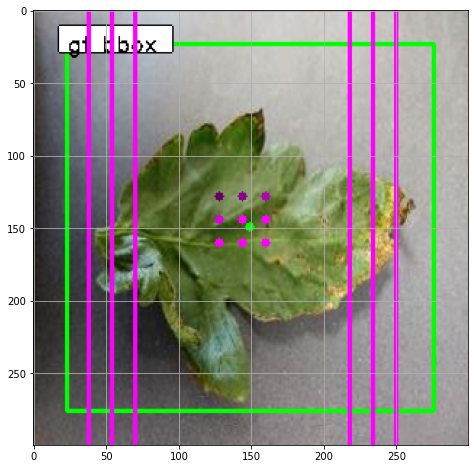

In [ ]:
print('Original image: height=%d width=%d'%(image_data['height'], image_data['width']))
print('Resized image:  height=%d width=%d C.im_size=%d'%(X.shape[1], X.shape[2], C.im_size))
print('Feature map size: height=%d width=%d C.rpn_stride=%d'%(Y[0].shape[1], Y[0].shape[2], C.rpn_stride))
print(X.shape)
print(str(len(Y))+" includes 'y_rpn_cls' and 'y_rpn_regr'")
print('Shape of y_rpn_cls {}'.format(Y[0].shape))
print('Shape of y_rpn_regr {}'.format(Y[1].shape))
print(image_data)

print('Number of positive anchors for this image: %d' % (debug_num_pos))
if debug_num_pos==0:
    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['height']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['height'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['width']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['width'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    plt.grid()
    plt.imshow(img)
    plt.show()
else:
    cls = Y[0][0]
    pos_cls = np.where(cls==1)
    print(pos_cls)
    regr = Y[1][0]
    pos_regr = np.where(regr==1)
    print(pos_regr)
    print('y_rpn_cls for possible pos anchor: {}'.format(cls[pos_cls[0][0],pos_cls[1][0],:]))
    print('y_rpn_regr for positive anchor: {}'.format(regr[pos_regr[0][0],pos_regr[1][0],:]))

    gt_x1, gt_x2 = image_data['bboxes'][0]['x1']*(X.shape[2]/image_data['width']), image_data['bboxes'][0]['x2']*(X.shape[2]/image_data['width'])
    gt_y1, gt_y2 = image_data['bboxes'][0]['y1']*(X.shape[1]/image_data['height']), image_data['bboxes'][0]['y2']*(X.shape[1]/image_data['height'])
    gt_x1, gt_y1, gt_x2, gt_y2 = int(gt_x1), int(gt_y1), int(gt_x2), int(gt_y2)

    img = debug_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color = (0, 255, 0)
    #   cv2.putText(img, 'gt bbox', (gt_x1, gt_y1-5), cv2.FONT_HERSHEY_DUPLEX, 0.7, color, 1)
    cv2.rectangle(img, (gt_x1, gt_y1), (gt_x2, gt_y2), color, 2)
    cv2.circle(img, (int((gt_x1+gt_x2)/2), int((gt_y1+gt_y2)/2)), 3, color, -1)

    # Add text
    textLabel = 'gt bbox'
    (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.5,1)
    textOrg = (gt_x1, gt_y1+5)
    cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 2)
    cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
    cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.5, (0, 0, 0), 1)

    # Draw positive anchors according to the y_rpn_regr
    for i in range(debug_num_pos):

        color = (100+i*(155/4), 0, 100+i*(155/4))

        idx = pos_regr[2][i*4]/4
        anchor_size = C.anchor_box_scales[int(idx/3)]
        anchor_ratio = C.anchor_box_ratios[2-int((idx+1)%3)]

        center = (pos_regr[1][i*4]*C.rpn_stride, pos_regr[0][i*4]*C.rpn_stride)
        print('Center position of positive anchor: ', center)
        cv2.circle(img, center, 3, color, -1)
        anc_w, anc_h = anchor_size*anchor_ratio[0], anchor_size*anchor_ratio[1]
        cv2.rectangle(img, (center[0]-int(anc_w/2), center[1]-int(anc_h/2)), (center[0]+int(anc_w/2), center[1]+int(anc_h/2)), color, 2)
#         cv2.putText(img, 'pos anchor bbox '+str(i+1), (center[0]-int(anc_w/2), center[1]-int(anc_h/2)-5), cv2.FONT_HERSHEY_DUPLEX, 0.5, color, 1)

print('Green bboxes is ground-truth bbox. Others are positive anchors')
plt.figure(figsize=(8,8))
plt.grid()
plt.imshow(img)
plt.show()

####Training

In [ ]:
input_shape_img = (None, None, 3)

img_input = Input(shape=input_shape_img)
roi_input = Input(shape=(None, 4))

# define the base network 
shared_layers = nn_base(img_input, trainable=True)

In [ ]:
# define the RPN, built on the base layers
num_anchors = len(C.anchor_box_scales) * len(C.anchor_box_ratios) # 9
rpn = rpn_layer(shared_layers, num_anchors)

classifier = classifier_layer(shared_layers, roi_input, C.num_rois, nb_classes=len(classes_count))

model_rpn = Model(img_input, rpn[:2])
model_classifier = Model([img_input, roi_input], classifier)

# this is a model that holds both the RPN and the classifier, used to load/save weights for the models
model_all = Model([img_input, roi_input], rpn[:2] + classifier)

# Because the google colab can only run the session several hours one time (then you need to connect again), 
# we need to save the model and load the model to continue training
if not os.path.isfile(C.model_path):
    #If this is the begin of the training, load the pre-traind base network such as vgg-16
    try:
        print('This is the first time of your training')
        print('loading weights from {}'.format(C.base_net_weights))
        model_rpn.load_weights(C.base_net_weights, by_name=True)
        model_classifier.load_weights(C.base_net_weights, by_name=True)
    except:
        print('Could not load pretrained model weights. Weights can be found in the keras application folder \
            https://github.com/fchollet/keras/tree/master/keras/applications')
    
    # Create the record.csv file to record losses, acc and mAP
    record_df = pd.DataFrame(columns=['mean_overlapping_bboxes', 'class_acc', 'loss_rpn_cls', 'loss_rpn_regr', 'loss_class_cls', 'loss_class_regr', 'curr_loss', 'elapsed_time', 'mAP'])
else:
    # If this is a continued training, load the trained model from before
    print('Continue training based on previous trained model')
    print('Loading weights from {}'.format(C.model_path))
    model_rpn.load_weights(C.model_path, by_name=True)
    model_classifier.load_weights(C.model_path, by_name=True)
    
    # Load the records
    record_df = pd.read_csv(record_path)

    r_mean_overlapping_bboxes = record_df['mean_overlapping_bboxes']
    r_class_acc = record_df['class_acc']
    r_loss_rpn_cls = record_df['loss_rpn_cls']
    r_loss_rpn_regr = record_df['loss_rpn_regr']
    r_loss_class_cls = record_df['loss_class_cls']
    r_loss_class_regr = record_df['loss_class_regr']
    r_curr_loss = record_df['curr_loss']
    r_elapsed_time = record_df['elapsed_time']
    r_mAP = record_df['mAP']

    print('Already train %dK batches'% (len(record_df)))



Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Continue training based on previous trained model
Loading weights from /content/gdrive/MyDrive/copy_tomato_disease_detection/model/model2.hdf5






Already train 23K batches


In [ ]:
optimizer = Adam(lr=1e-5)
optimizer_classifier = Adam(lr=1e-5)
model_rpn.compile(optimizer=optimizer, loss=[rpn_loss_cls(num_anchors), rpn_loss_regr(num_anchors)])
model_classifier.compile(optimizer=optimizer_classifier, loss=[class_loss_cls, class_loss_regr(len(classes_count)-1)], metrics={'dense_class_{}'.format(len(classes_count)): 'accuracy'})
model_all.compile(optimizer='sgd', loss='mae')



Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [ ]:
# Training setting
total_epochs = len(record_df)
r_epochs = len(record_df)

epoch_length = 2000
num_epochs = 17
iter_num = 0

total_epochs += num_epochs

losses = np.zeros((epoch_length, 5))
rpn_accuracy_rpn_monitor = []
rpn_accuracy_for_epoch = []

if len(record_df)==0:
    best_loss = np.Inf
else:
    best_loss = np.min(r_curr_loss)

In [ ]:
print(len(record_df))


0


In [ ]:
start_time = time.time()
for epoch_num in range(num_epochs):

    progbar = generic_utils.Progbar(epoch_length)
    print('Epoch {}/{}'.format(r_epochs + 1, total_epochs))
    
    r_epochs += 1

    while True:
        try:

            if len(rpn_accuracy_rpn_monitor) == epoch_length and C.verbose:
                mean_overlapping_bboxes = float(sum(rpn_accuracy_rpn_monitor))/len(rpn_accuracy_rpn_monitor)
                rpn_accuracy_rpn_monitor = []
#                 print('Average number of overlapping bounding boxes from RPN = {} for {} previous iterations'.format(mean_overlapping_bboxes, epoch_length))
                if mean_overlapping_bboxes == 0:
                    print('RPN is not producing bounding boxes that overlap the ground truth boxes. Check RPN settings or keep training.')

            # Generate X (x_img) and label Y ([y_rpn_cls, y_rpn_regr])
            X, Y, img_data, debug_img, debug_num_pos = next(data_gen_train)

            # Train rpn model and get loss value [_, loss_rpn_cls, loss_rpn_regr]
            loss_rpn = model_rpn.train_on_batch(X, Y)

            # Get predicted rpn from rpn model [rpn_cls, rpn_regr]
            P_rpn = model_rpn.predict_on_batch(X)

            # R: bboxes (shape=(300,4))
            # Convert rpn layer to roi bboxes
            R = rpn_to_roi(P_rpn[0], P_rpn[1], C, K.image_data_format(), use_regr=True, overlap_thresh=0.7, max_boxes=300)
            
            # note: calc_iou converts from (x1,y1,x2,y2) to (x,y,w,h) format
            # X2: bboxes that iou > C.classifier_min_overlap for all gt bboxes in 300 non_max_suppression bboxes
            # Y1: one hot code for bboxes from above => x_roi (X)
            # Y2: corresponding labels and corresponding gt bboxes
            X2, Y1, Y2, IouS = calc_iou(R, img_data, C, class_mapping)

            # If X2 is None means there are no matching bboxes
            if X2 is None:
                rpn_accuracy_rpn_monitor.append(0)
                rpn_accuracy_for_epoch.append(0)
                continue
            
            # Find out the positive anchors and negative anchors
            neg_samples = np.where(Y1[0, :, -1] == 1)
            pos_samples = np.where(Y1[0, :, -1] == 0)

            if len(neg_samples) > 0:
                neg_samples = neg_samples[0]
            else:
                neg_samples = []

            if len(pos_samples) > 0:
                pos_samples = pos_samples[0]
            else:
                pos_samples = []

            rpn_accuracy_rpn_monitor.append(len(pos_samples))
            rpn_accuracy_for_epoch.append((len(pos_samples)))

            if C.num_rois > 1:
                # If number of positive anchors is larger than 4//2 = 2, randomly choose 2 pos samples
                if len(pos_samples) < C.num_rois//2:
                    selected_pos_samples = pos_samples.tolist()
                else:
                    selected_pos_samples = np.random.choice(pos_samples, C.num_rois//2, replace=False).tolist()
                
                # Randomly choose (num_rois - num_pos) neg samples
                try:
                    selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=False).tolist()
                except:
                    selected_neg_samples = np.random.choice(neg_samples, C.num_rois - len(selected_pos_samples), replace=True).tolist()
                
                # Save all the pos and neg samples in sel_samples
                sel_samples = selected_pos_samples + selected_neg_samples
            else:
                # in the extreme case where num_rois = 1, we pick a random pos or neg sample
                selected_pos_samples = pos_samples.tolist()
                selected_neg_samples = neg_samples.tolist()
                if np.random.randint(0, 2):
                    sel_samples = random.choice(neg_samples)
                else:
                    sel_samples = random.choice(pos_samples)

            # training_data: [X, X2[:, sel_samples, :]]
            # labels: [Y1[:, sel_samples, :], Y2[:, sel_samples, :]]
            #  X                     => img_data resized image
            #  X2[:, sel_samples, :] => num_rois (4 in here) bboxes which contains selected neg and pos
            #  Y1[:, sel_samples, :] => one hot encode for num_rois bboxes which contains selected neg and pos
            #  Y2[:, sel_samples, :] => labels and gt bboxes for num_rois bboxes which contains selected neg and pos
            loss_class = model_classifier.train_on_batch([X, X2[:, sel_samples, :]], [Y1[:, sel_samples, :], Y2[:, sel_samples, :]])

            losses[iter_num, 0] = loss_rpn[1]
            losses[iter_num, 1] = loss_rpn[2]

            losses[iter_num, 2] = loss_class[1]
            losses[iter_num, 3] = loss_class[2]
            losses[iter_num, 4] = loss_class[3]

            iter_num += 1

            progbar.update(iter_num, [('rpn_cls', np.mean(losses[:iter_num, 0])), ('rpn_regr', np.mean(losses[:iter_num, 1])),
                                      ('final_cls', np.mean(losses[:iter_num, 2])), ('final_regr', np.mean(losses[:iter_num, 3]))])

            if iter_num == epoch_length:
                loss_rpn_cls = np.mean(losses[:, 0])
                loss_rpn_regr = np.mean(losses[:, 1])
                loss_class_cls = np.mean(losses[:, 2])
                loss_class_regr = np.mean(losses[:, 3])
                class_acc = np.mean(losses[:, 4])

                mean_overlapping_bboxes = float(sum(rpn_accuracy_for_epoch)) / len(rpn_accuracy_for_epoch)
                rpn_accuracy_for_epoch = []

                if C.verbose:
                    print('Mean number of bounding boxes from RPN overlapping ground truth boxes: {}'.format(mean_overlapping_bboxes))
                    print('Classifier accuracy for bounding boxes from RPN: {}'.format(class_acc))
                    print('Loss RPN classifier: {}'.format(loss_rpn_cls))
                    print('Loss RPN regression: {}'.format(loss_rpn_regr))
                    print('Loss Detector classifier: {}'.format(loss_class_cls))
                    print('Loss Detector regression: {}'.format(loss_class_regr))
                    print('Total loss: {}'.format(loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr))
                    print('Elapsed time: {}'.format(time.time() - start_time))
                    elapsed_time = (time.time()-start_time)/60

                curr_loss = loss_rpn_cls + loss_rpn_regr + loss_class_cls + loss_class_regr
                iter_num = 0
                start_time = time.time()

                if curr_loss < best_loss:
                    if C.verbose:
                        print('Total loss decreased from {} to {}, saving weights'.format(best_loss,curr_loss))
                    best_loss = curr_loss
                    model_all.save_weights(C.model_path)

                new_row = {'mean_overlapping_bboxes':round(mean_overlapping_bboxes, 3), 
                           'class_acc':round(class_acc, 3), 
                           'loss_rpn_cls':round(loss_rpn_cls, 3), 
                           'loss_rpn_regr':round(loss_rpn_regr, 3), 
                           'loss_class_cls':round(loss_class_cls, 3), 
                           'loss_class_regr':round(loss_class_regr, 3), 
                           'curr_loss':round(curr_loss, 3), 
                           'elapsed_time':round(elapsed_time, 3), 
                           'mAP': 0}

                record_df = record_df.append(new_row, ignore_index=True)
                record_df.to_csv(record_path, index=0)

                break

        except Exception as e:
            print('Exception: {}'.format(e))
            continue

print('Training complete, exiting.')

Epoch 24/40


2000/2000 [==============================] - 1093s 546ms/step - rpn_cls: 0.2042 - rpn_regr: 0.0217 - final_cls: 0.8690 - final_regr: 0.0906
Mean number of bounding boxes from RPN overlapping ground truth boxes: 13.291
Classifier accuracy for bounding boxes from RPN: 0.843625
Loss RPN classifier: 0.16553507997387482
Loss RPN regression: 0.019283634941326455
Loss Detector classifier: 0.5256784102988908
Loss Detector regression: 0.07909612351283431
Total loss: 0.7895932487269265
Elapsed time: 1092.910327911377
Epoch 25/40
2000/2000 [==============================] - 1080s 540ms/step - rpn_cls: 0.1360 - rpn_regr: 0.0177 - final_cls: 0.3038 - final_regr: 0.0713
Mean number of bounding boxes from RPN overlapping ground truth boxes: 13.4675
Classifier accuracy for bounding boxes from RPN: 0.908
Loss RPN classifier: 0.1371936777854557
Loss RPN regression: 0.018239664894907037
Loss Detector classifier: 0.30110518795957686
Loss Detector regression: 0.07145528322702739
Total loss: 0

In [ ]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['mean_overlapping_bboxes'], 'r')
plt.title('mean_overlapping_bboxes')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['class_acc'], 'r')
plt.title('class_acc')

plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'r')
plt.title('loss_rpn_cls')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'r')
plt.title('loss_rpn_regr')
plt.show()


plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
plt.title('loss_class_cls')
plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'r')
plt.title('loss_class_regr')
plt.show()

plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
plt.title('total_loss')
plt.show()

# plt.figure(figsize=(15,5))
# plt.subplot(1,2,1)
# plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
# plt.title('total_loss')
# plt.subplot(1,2,2)
# plt.plot(np.arange(0, r_epochs), record_df['elapsed_time'], 'r')
# plt.title('elapsed_time')
# plt.show()

# plt.title('loss')
# plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'b')
# plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'g')
# plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
# plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'c')
# # plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'm')
# plt.show()

##Testing

In [ ]:
base_path = '/content/gdrive/MyDrive/copy_tomato_disease_detection'

test_path = '/content/gdrive/MyDrive/copy_tomato_disease_detection/test.txt' # Test data (annotation file)

test_base_path = '/content/gdrive/MyDrive/copy_tomato_disease_detection/test' # Directory to save the test images

config_output_filename = os.path.join(base_path, 'model_vgg_config2.pickle')

In [ ]:
with open(config_output_filename, 'rb') as f_in:
	C = pickle.load(f_in)

# turn off any data augmentation at test time
C.use_horizontal_flips = False
C.use_vertical_flips = False
C.rot_90 = False

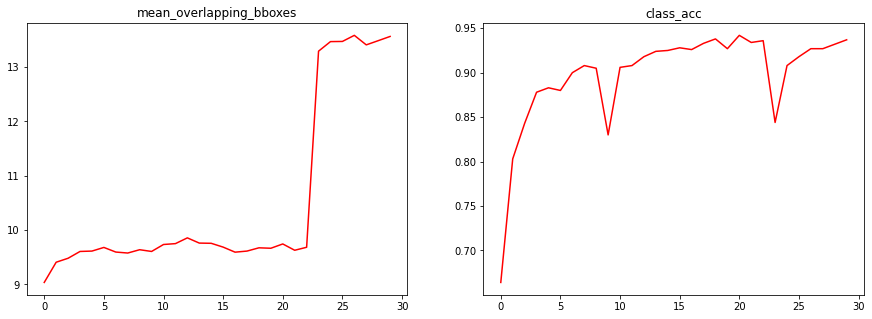

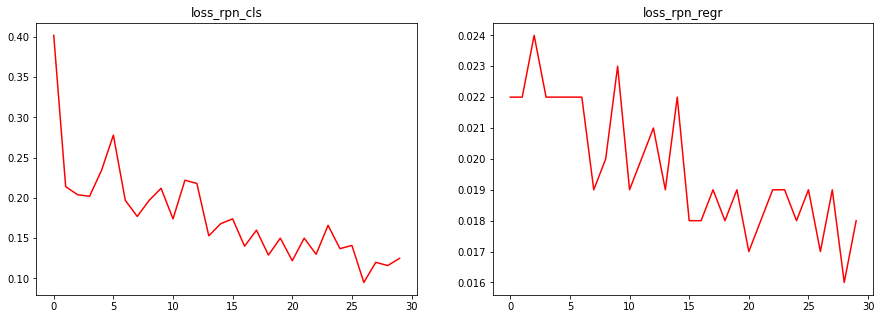

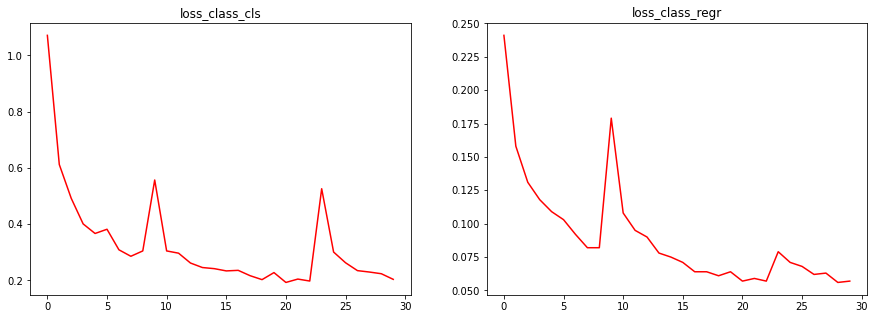

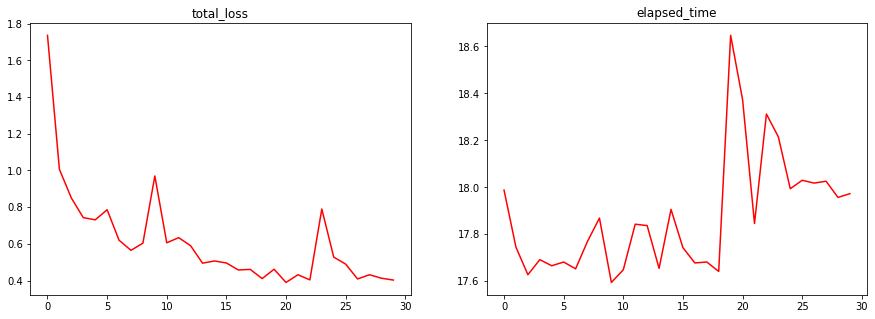

In [ ]:
# Load the records
record_df = pd.read_csv(C.record_path)

r_epochs = len(record_df)

plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['mean_overlapping_bboxes'], 'r')
plt.title('mean_overlapping_bboxes')

plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['class_acc'], 'r')
plt.title('class_acc')

plt.show()

plt.figure(figsize=(15,5))

plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_cls'], 'r')
plt.title('loss_rpn_cls')

plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_rpn_regr'], 'r')
plt.title('loss_rpn_regr')
plt.show()
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_cls'], 'r')
plt.title('loss_class_cls')

plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['loss_class_regr'], 'r')
plt.title('loss_class_regr')
plt.show()
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(np.arange(0, r_epochs), record_df['curr_loss'], 'r')
plt.title('total_loss')

plt.subplot(1,2,2)
plt.plot(np.arange(0, r_epochs), record_df['elapsed_time'], 'r')
plt.title('elapsed_time')

plt.show()

#### Utility functions

In [ ]:
def format_img_size(img, C):
	""" formats the image size based on config """
	img_min_side = float(C.im_size)
	(height,width,_) = img.shape
		
	if width <= height:
		ratio = img_min_side/width
		new_height = int(ratio * height)
		new_width = int(img_min_side)
	else:
		ratio = img_min_side/height
		new_width = int(ratio * width)
		new_height = int(img_min_side)
	img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)
	return img, ratio	

def format_img_channels(img, C):
	""" formats the image channels based on config """
	img = img[:, :, (2, 1, 0)]
	img = img.astype(np.float32)
	img[:, :, 0] -= C.img_channel_mean[0]
	img[:, :, 1] -= C.img_channel_mean[1]
	img[:, :, 2] -= C.img_channel_mean[2]
	img /= C.img_scaling_factor
	img = np.transpose(img, (2, 0, 1))
	img = np.expand_dims(img, axis=0)
	return img

def format_img(img, C):
	""" formats an image for model prediction based on config """
	img, ratio = format_img_size(img, C)
	img = format_img_channels(img, C)
	return img, ratio

# Method to transform the coordinates of the bounding box to its original size
def get_real_coordinates(ratio, x1, y1, x2, y2):

	real_x1 = int(round(x1 // ratio))
	real_y1 = int(round(y1 // ratio))
	real_x2 = int(round(x2 // ratio))
	real_y2 = int(round(y2 // ratio))

	return (real_x1, real_y1, real_x2 ,real_y2)

####Testing

In [ ]:
num_features = 512

input_shape_img = (None, None, 3)
input_shape_features = (None, None, num_features)

img_input = Input(shape=input_shape_img)
roi_input = Input(shape=(C.num_rois, 4))
feature_map_input = Input(shape=input_shape_features)

# define the base network (VGG here, can be Resnet50, Inception, etc)
shared_layers = nn_base(img_input, trainable=True)

# define the RPN, built on the base layers
num_anchors = len(C.anchor_box_scales) * len(C.anchor_box_ratios)
rpn_layers = rpn_layer(shared_layers, num_anchors)

classifier = classifier_layer(feature_map_input, roi_input, C.num_rois, nb_classes=len(C.class_mapping))

model_rpn = Model(img_input, rpn_layers)
model_classifier_only = Model([feature_map_input, roi_input], classifier)

model_classifier = Model([feature_map_input, roi_input], classifier)

print('Loading weights from {}'.format(C.model_path))
model_rpn.load_weights(C.model_path, by_name=True)
model_classifier.load_weights(C.model_path, by_name=True)

model_rpn.compile(optimizer='sgd', loss='mse')
model_classifier.compile(optimizer='sgd', loss='mse')







Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Loading weights from /content/gdrive/MyDrive/copy_tomato_disease_detection/model/model2.hdf5









In [ ]:
# Switch key value for class mapping
class_mapping = C.class_mapping
class_mapping = {v: k for k, v in class_mapping.items()}
print(class_mapping)
class_to_color = {class_mapping[v]: np.random.randint(0, 255, 3) for v in class_mapping}

{0: 'Tomato___Late_blight', 1: 'Tomato___Septoria_leaf_spot', 2: 'Tomato___healthy', 3: 'Tomato___Leaf_Mold', 4: 'Tomato___Tomato_mosaic_virus', 5: 'Tomato___Bacterial_spot', 6: 'Tomato___Yellow_Leaf_Curl_Virus', 7: 'Tomato___Early_blight', 8: 'Tomato___Spider_mites', 9: 'Tomato___Target_Spot', 10: 'bg'}


In [ ]:
test_imgs = os.listdir(test_base_path)

imgs_path = []
for i in range(len(test_imgs)):
	imgs_path.append(test_imgs[i])

all_imgs = []

classes = {}

In [ ]:
%cd /content/gdrive/MyDrive/copy_tomato_disease_detection

/content/gdrive/MyDrive/copy_tomato_disease_detection


In [ ]:
import pandas as pd
test_df=pd.read_csv('test_tomato.csv')
test_df.head()

,Unnamed: 0,filename,xmin,xmax,ymin,ymax,class_name
0,0,039b47d574bc4bb8a14259a1cd96a741_jpg.rf.1f0673...,215,396,175,338,Tomato___Early_blight
1,1,tomato_V8_jpg.rf.e1164be93cb21b93129b06436caac...,13,258,10,219,Tomato___Bacterial_spot
2,2,tomato_V8_jpg.rf.e1164be93cb21b93129b06436caac...,12,405,197,408,Tomato___Bacterial_spot
3,3,0_jpg.rf.244833b96516844a6bd5967bdb9d704f.jpg,211,341,157,292,Tomato___Septoria_leaf_spot
4,4,0_jpg.rf.244833b96516844a6bd5967bdb9d704f.jpg,59,202,157,292,Tomato___Septoria_leaf_spot


039b47d574bc4bb8a14259a1cd96a741_jpg.rf.1f0673225f876af4143d937a5bee973c.jpg
Elapsed time = 7.019649982452393
[]
Actual= Tomato___Early_blight


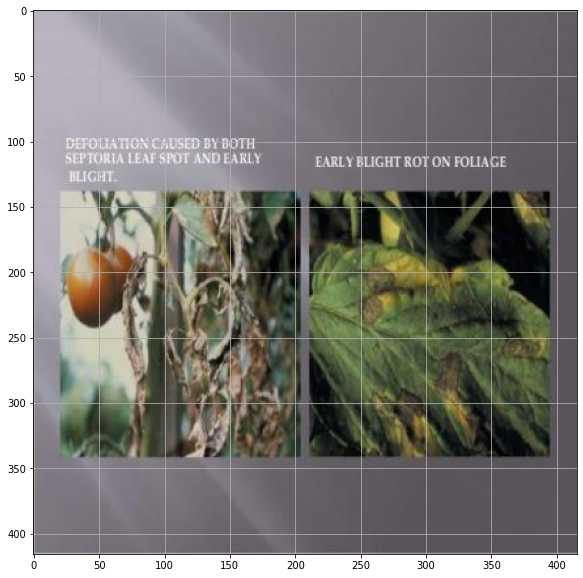

tomato_V8_jpg.rf.e1164be93cb21b93129b06436caac7c9.jpg
Elapsed time = 7.09535813331604
[('Tomato___Bacterial_spot', 66.12008213996887)]
Actual= Tomato___Bacterial_spot


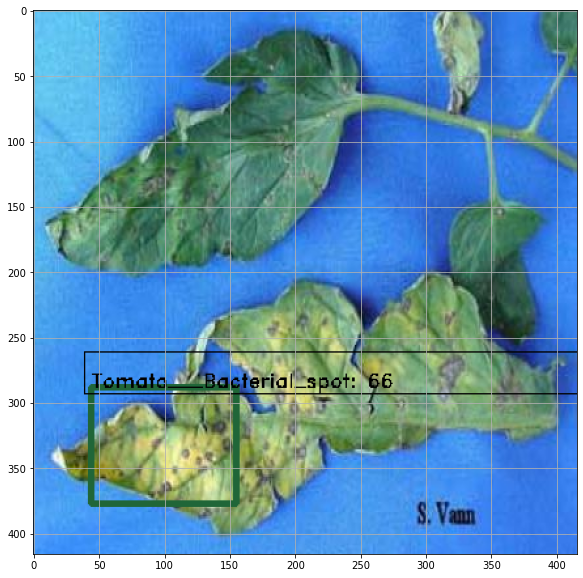

0_jpg.rf.244833b96516844a6bd5967bdb9d704f.jpg
Elapsed time = 7.11978006362915
[('Tomato___Bacterial_spot', 70.12514472007751), ('Tomato___Bacterial_spot', 61.08930706977844)]
Actual= Tomato___Septoria_leaf_spot


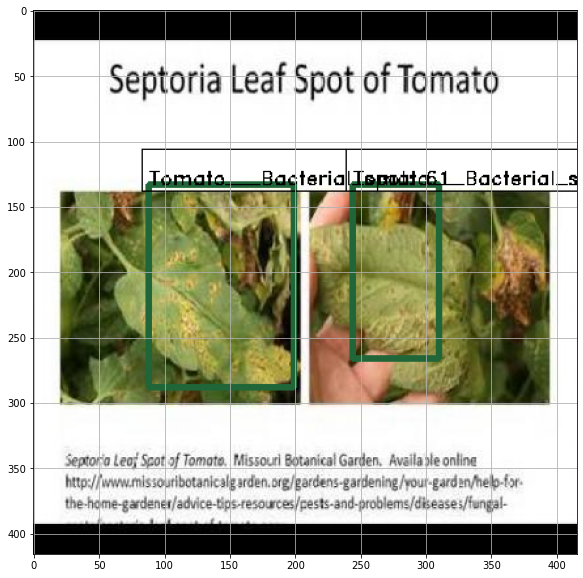

18c_jpg.rf.c8d9a4258442388e02380347253bd241.jpg
Elapsed time = 7.065438270568848
[('Tomato___Yellow_Leaf_Curl_Virus', 99.99204874038696)]
Actual= Tomato___Late_blight


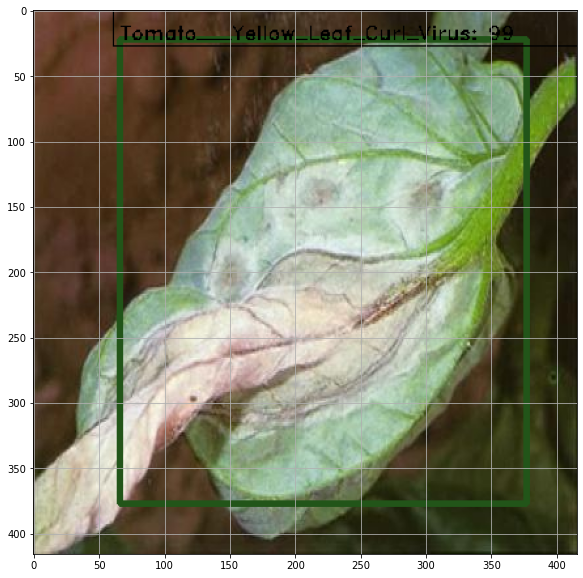

6447731_orig_jpg.rf.85458f4dd3c3ee26dadfe6a18165276b.jpg
Elapsed time = 7.129063606262207
[]
Actual= Tomato___Septoria_leaf_spot


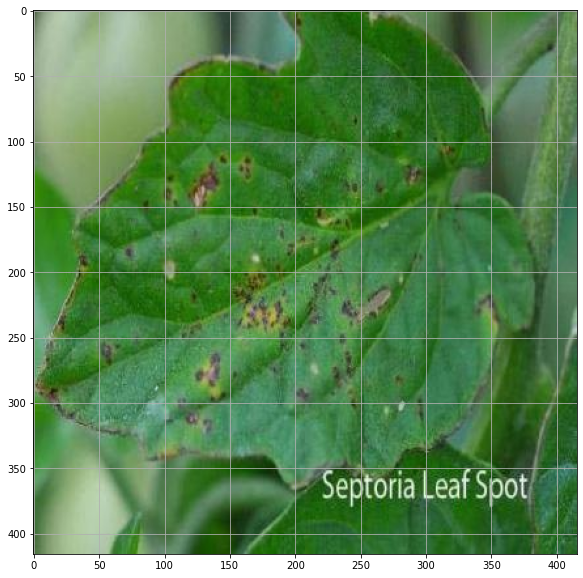

page_2_jpg.rf.e00a689b3798f19df9b24f6f542cd400.jpg
Elapsed time = 7.1188905239105225
[('Tomato___Late_blight', 80.07590174674988), ('Tomato___Late_blight', 73.138427734375), ('Tomato___Late_blight', 72.08030819892883), ('Tomato___Late_blight', 71.0231363773346), ('Tomato___Late_blight', 65.5019998550415), ('Tomato___Early_blight', 63.03447484970093)]
Actual= Tomato___Tomato_mosaic_virus


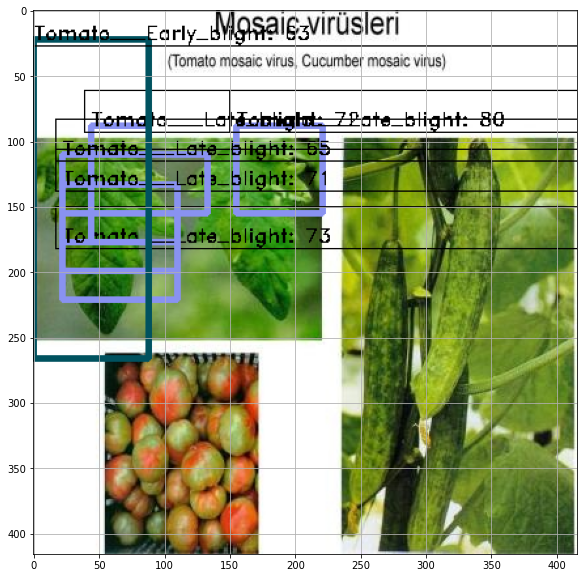

ill-tomato-of-tomato-mosaic-virus-DBE17N_jpg.rf.23b91bd552b8b6c3ff5226d42cae43c5.jpg
Elapsed time = 7.112493515014648
[('Tomato___Late_blight', 80.70152997970581), ('Tomato___Late_blight', 77.69917249679565), ('Tomato___Late_blight', 74.4559645652771), ('Tomato___Late_blight', 73.16375970840454), ('Tomato___Late_blight', 64.03095126152039), ('Tomato___Late_blight', 63.376909494400024), ('Tomato___Late_blight', 63.02880644798279), ('Tomato___Late_blight', 62.50537037849426), ('Tomato___Late_blight', 62.14041709899902), ('Tomato___Late_blight', 62.095749378204346), ('Tomato___Late_blight', 61.68673038482666), ('Tomato___Late_blight', 61.122626066207886), ('Tomato___Late_blight', 60.87272763252258), ('Tomato___Late_blight', 60.48794388771057)]
Actual= Tomato___Tomato_mosaic_virus


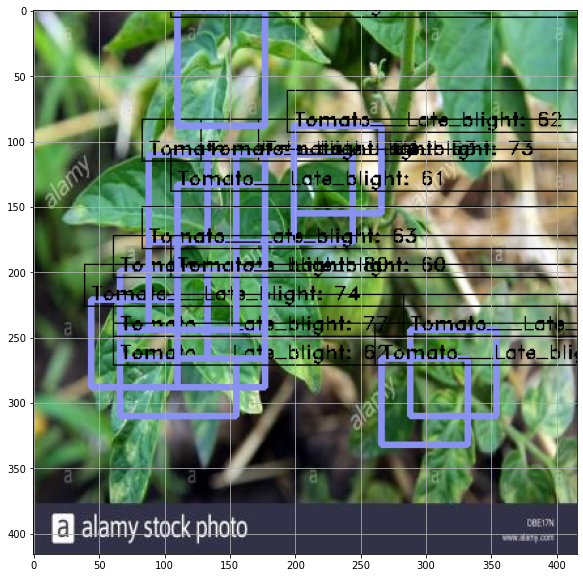

IMG_5808_jpg.rf.38d9d71c5d81b5a744eb70f26aa15cb1.jpg
Elapsed time = 7.136193752288818
[]
Actual= Tomato___Late_blight


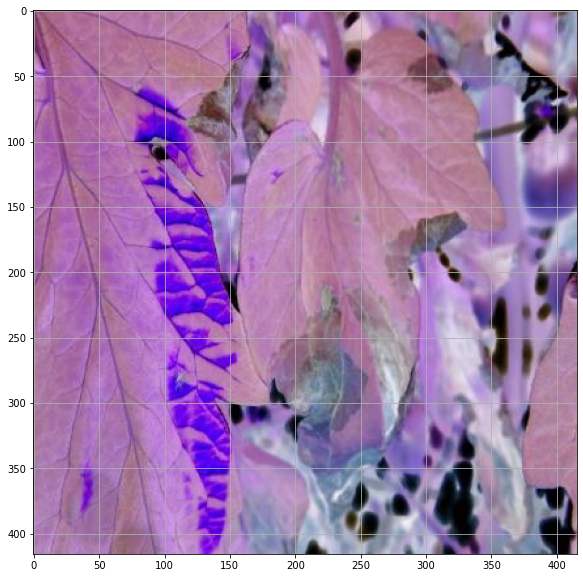

fungus-univ-of-minnesoeta_jpg.rf.f3ee750055c87b145f7fe671c0eb8d7e.jpg
Elapsed time = 7.1360015869140625
[]
Actual= Tomato___Leaf_Mold


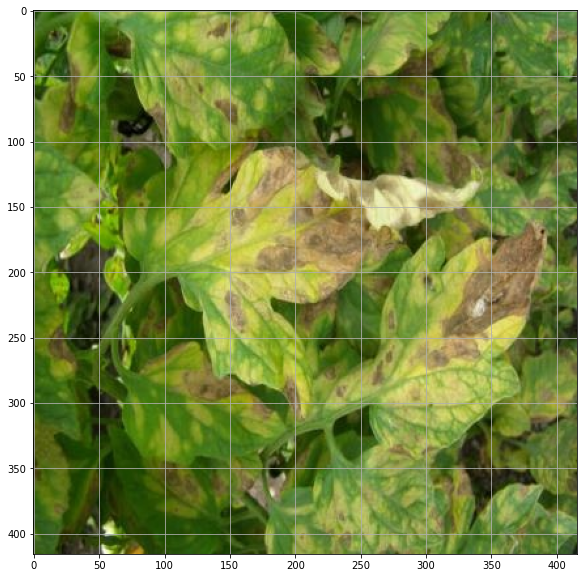

dscn3175_jpg.rf.85c7b517ea4d59289f83a8f41ec2de6e.jpg
Elapsed time = 7.142033338546753
[]
Actual= Tomato___Early_blight


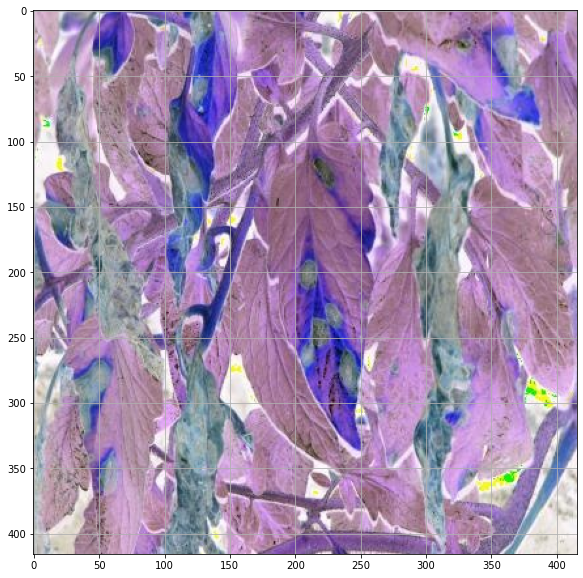

BIGSD_jpg.rf.bb959e384339bd47994aedf863d45306.jpg
Elapsed time = 7.194089651107788
[]
Actual= Tomato___Leaf_Mold


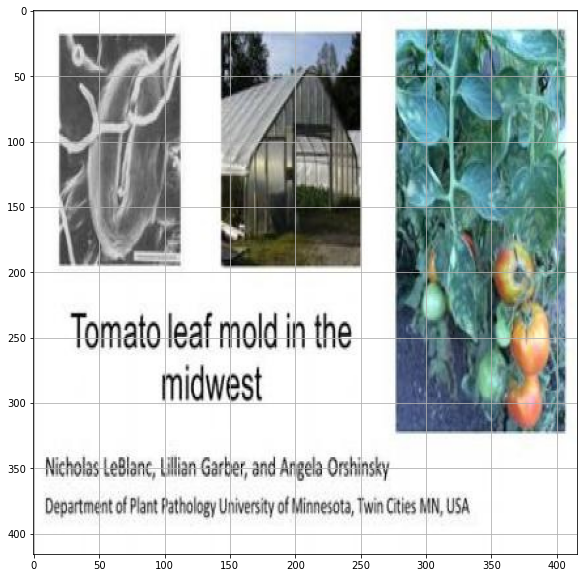

image_jpg.rf.d37866429a917dd1bc5352ea1454a472.jpg
Elapsed time = 7.170536279678345
[('Tomato___Yellow_Leaf_Curl_Virus', 80.71962594985962)]
Actual= Tomato___Late_blight


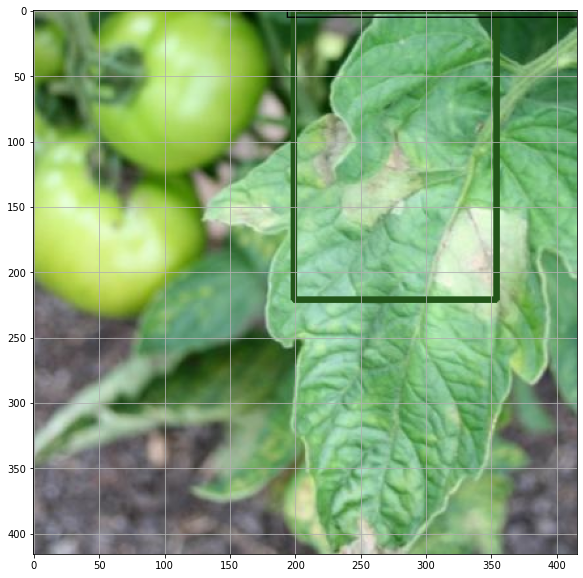

tomato_bacterial-speck_01_zoom_jpg.rf.0716a6bf0124b8026c226220b953bc08.jpg
Elapsed time = 7.1848814487457275
[('Tomato___healthy', 76.56413912773132)]
Actual= Tomato___Bacterial_spot


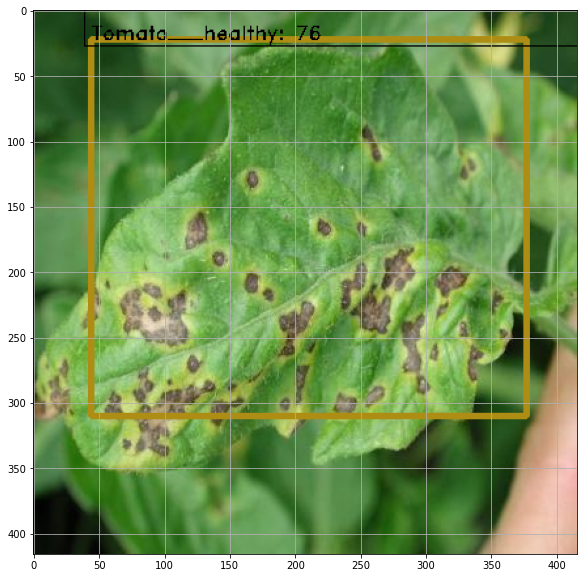

bact-spot-fig-1_jpg.rf.f0892b41ecdeb8ac72c13c807bc8e117.jpg
Elapsed time = 7.176953077316284
[('Tomato___Bacterial_spot', 69.0738320350647)]
Actual= Tomato___Bacterial_spot


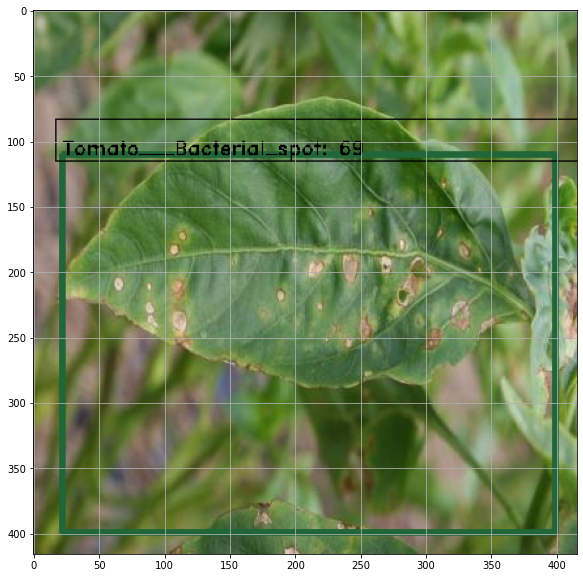

Shoemaker_7068_JPG_jpg.rf.da4a7d4d7f08cf5bdcfc4e6ddfb448f0.jpg
Elapsed time = 7.259969711303711
[('Tomato___Spider_mites', 63.42930197715759)]
Actual= Tomato___Early_blight


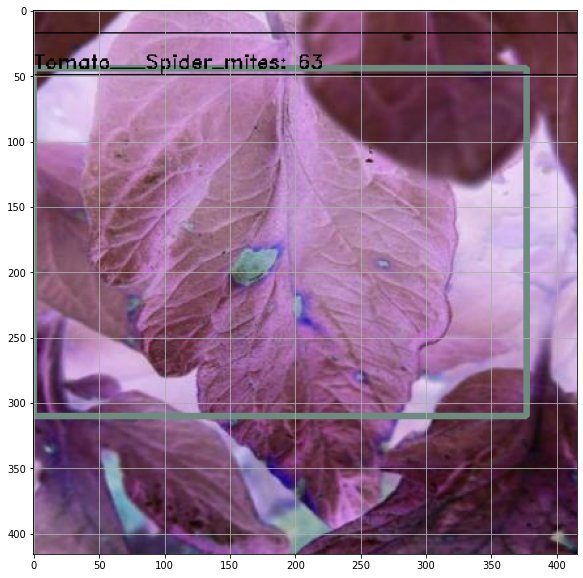

tmv-tomato-9_jpg.rf.ab75165b17fb8f3a35159af023c6a34a.jpg
Elapsed time = 7.19770073890686
[]
Actual= Tomato___Tomato_mosaic_virus


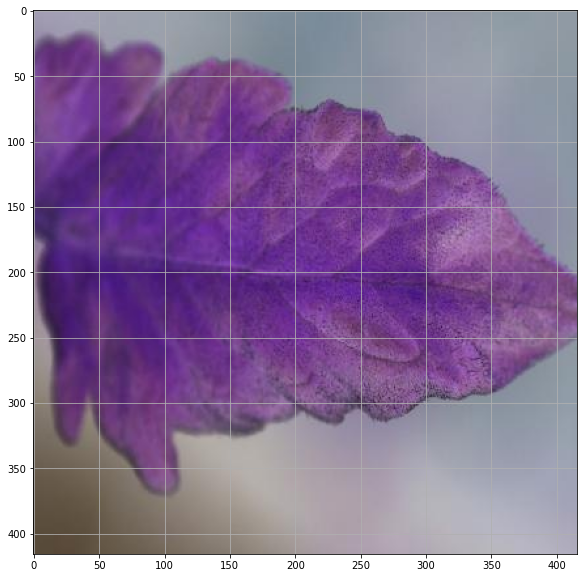

black_leaf_mold_in_zina_tina_jpg.rf.9cd748878b55ed1847d5cb33281f1404.jpg
Elapsed time = 7.165485620498657
[]
Actual= Tomato___Leaf_Mold


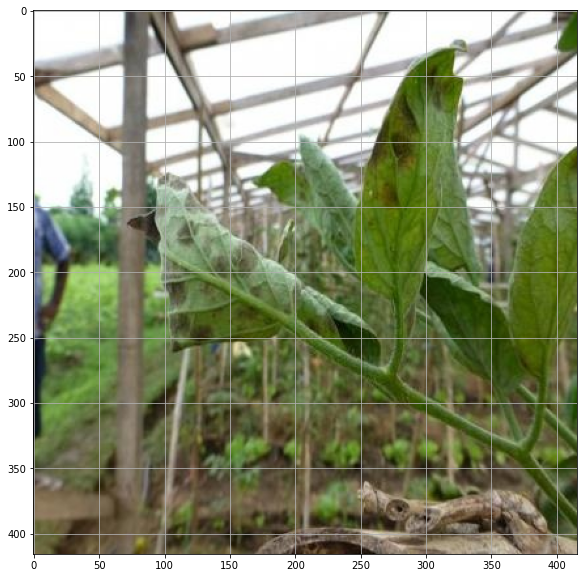

17fc47_jpg.rf.fe1c3b512f4182d08f00ac2c612ddb1c.jpg
Elapsed time = 7.2269487380981445
[('Tomato___Late_blight', 94.00849938392639), ('Tomato___Late_blight', 91.85161590576172), ('Tomato___Late_blight', 83.58262777328491), ('Tomato___Late_blight', 81.99779987335205), ('Tomato___Late_blight', 81.60562515258789), ('Tomato___Late_blight', 80.2816092967987), ('Tomato___Late_blight', 79.10711169242859), ('Tomato___Late_blight', 78.65355014801025), ('Tomato___Late_blight', 77.70327925682068), ('Tomato___Late_blight', 73.63274693489075), ('Tomato___Late_blight', 71.79761528968811), ('Tomato___Late_blight', 71.66680097579956), ('Tomato___Late_blight', 70.09327411651611), ('Tomato___Late_blight', 69.76612210273743), ('Tomato___Late_blight', 66.16883277893066), ('Tomato___Late_blight', 65.78014492988586), ('Tomato___Late_blight', 64.1113817691803)]
Actual= Tomato___Yellow_Leaf_Curl_Virus


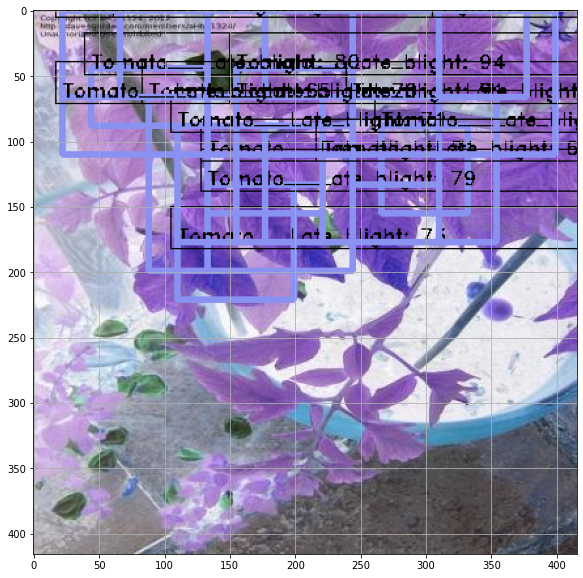

2septoria-tomato_jpg.rf.5e27f4ba45e692c8359dc02d4350f8da.jpg
Elapsed time = 7.203891038894653
[('Tomato___healthy', 78.36185097694397)]
Actual= Tomato___Septoria_leaf_spot


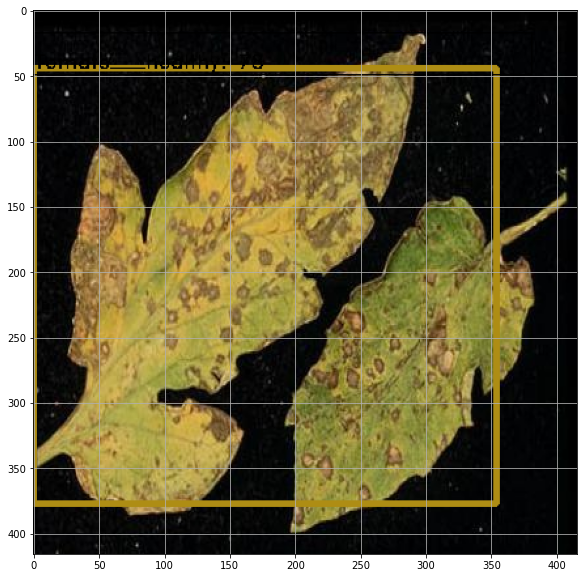

Tomato59_JPG_jpg.rf.66c6ae528d889ed81a8c5bc2497b7bff.jpg
Elapsed time = 7.237837314605713
[('Tomato___Late_blight', 94.61418390274048), ('Tomato___Late_blight', 90.74699878692627), ('Tomato___Late_blight', 87.00706958770752), ('Tomato___Late_blight', 83.98574590682983), ('Tomato___Late_blight', 83.26537013053894), ('Tomato___Late_blight', 81.20687007904053), ('Tomato___Late_blight', 77.23021507263184), ('Tomato___Late_blight', 71.32023572921753), ('Tomato___Late_blight', 71.27518653869629), ('Tomato___Late_blight', 71.23148441314697), ('Tomato___Late_blight', 70.31499743461609), ('Tomato___Late_blight', 68.34216117858887), ('Tomato___Late_blight', 63.70006203651428), ('Tomato___Late_blight', 63.41949701309204), ('Tomato___Late_blight', 62.852007150650024), ('Tomato___Late_blight', 62.21838593482971), ('Tomato___Late_blight', 62.015700340270996), ('Tomato___Late_blight', 61.19605302810669), ('Tomato___Late_blight', 60.99572777748108)]
Actual= Tomato___healthy


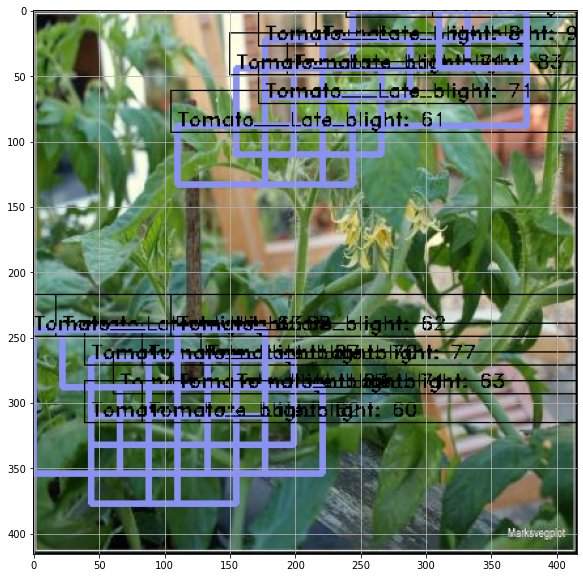

Tom_Bact3_jpg.rf.ab8da513672082934addba55600a71d2.jpg
Elapsed time = 7.229397535324097
[('Tomato___Yellow_Leaf_Curl_Virus', 66.33188128471375), ('Tomato___Target_Spot', 69.37126517295837)]
Actual= Tomato___Bacterial_spot


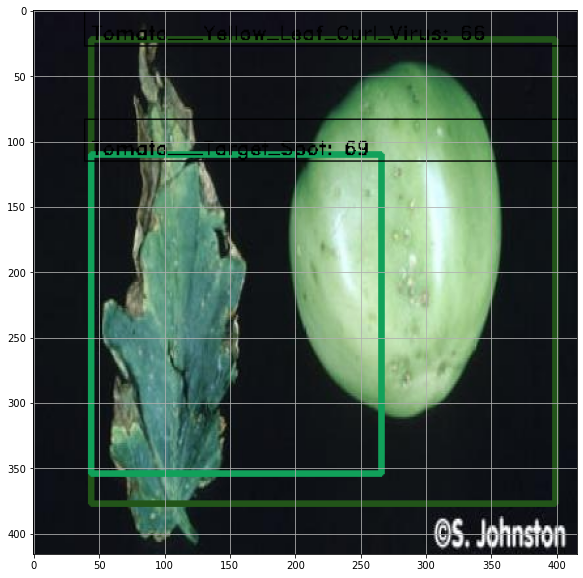

1684_jpg.rf.cbfc897f8e7f51b9da504d4a5c597b8f.jpg
Elapsed time = 7.18117880821228
[('Tomato___Late_blight', 88.1834328174591), ('Tomato___Late_blight', 87.51944899559021), ('Tomato___Late_blight', 67.91841983795166), ('Tomato___Late_blight', 63.94466757774353)]
Actual= Tomato___healthy


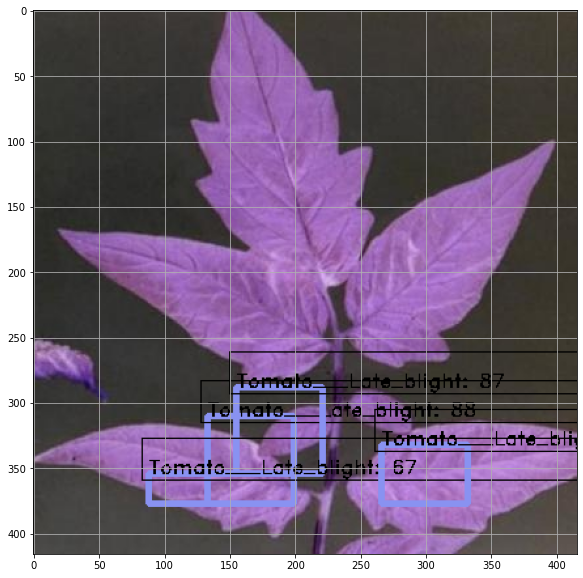

70_jpg.rf.c5c504060fc481cbb31672cda27ec6b0.jpg
Elapsed time = 7.193443059921265
[]
Actual= Tomato___Late_blight


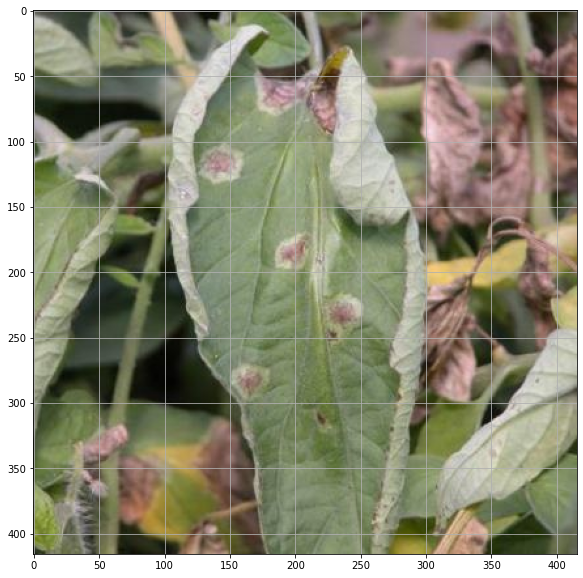

early-blight-septoria-ls-fig-3_jpg.rf.7b2e29c077910e0930c16d7aed136121.jpg
Elapsed time = 7.221702337265015
[]
Actual= Tomato___Septoria_leaf_spot


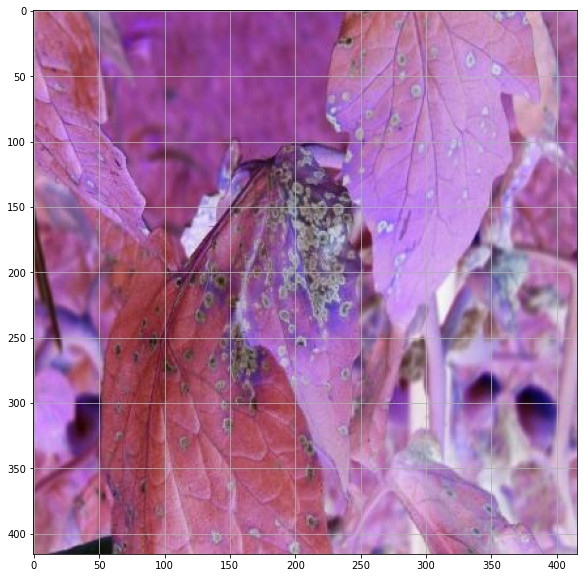

tomato_early-blight_01_zoom_jpg.rf.91897ea92f2da3c717d56cf88b3e46bf.jpg
Elapsed time = 7.28498101234436
[('Tomato___Target_Spot', 76.61059498786926)]
Actual= Tomato___Early_blight


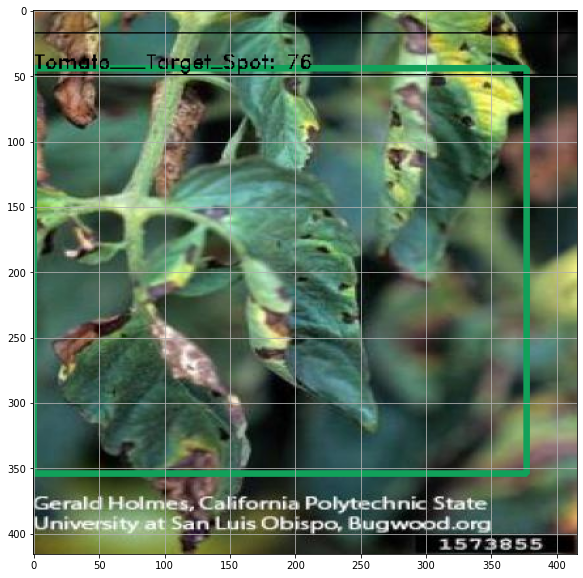

Tomato_leaf_jpg.rf.51d4654c5dbd98d7fdbbc3d5a312309a.jpg
Elapsed time = 7.293455600738525
[('Tomato___Late_blight', 99.96299743652344), ('Tomato___Late_blight', 99.78067278862), ('Tomato___Late_blight', 99.12561178207397), ('Tomato___Late_blight', 98.43909740447998), ('Tomato___Late_blight', 97.92044162750244), ('Tomato___Late_blight', 97.74773716926575), ('Tomato___Late_blight', 97.48865365982056), ('Tomato___Late_blight', 96.97498679161072), ('Tomato___Late_blight', 96.19724154472351), ('Tomato___Late_blight', 95.97002863883972), ('Tomato___Late_blight', 95.8377480506897), ('Tomato___Late_blight', 94.85782980918884), ('Tomato___Late_blight', 94.36968564987183), ('Tomato___Late_blight', 93.42626333236694), ('Tomato___Late_blight', 93.25888752937317), ('Tomato___Late_blight', 93.1838870048523), ('Tomato___Late_blight', 92.75844097137451), ('Tomato___Late_blight', 92.09641218185425), ('Tomato___Late_blight', 91.83290600776672), ('Tomato___Late_blight', 91.61018133163452), ('Tomato___Late

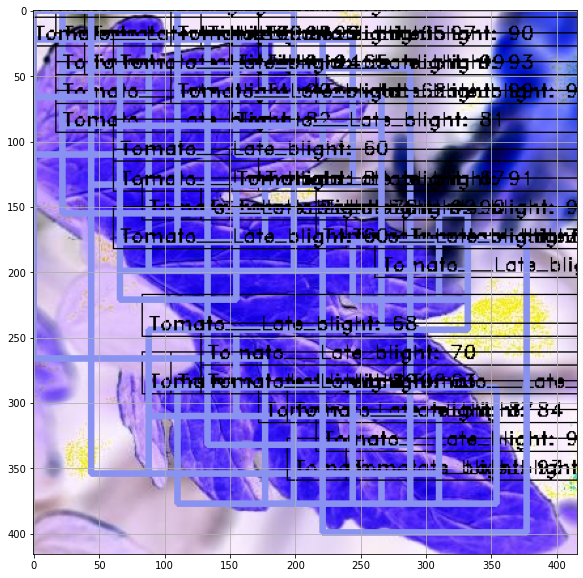

55830b60a7cf2_image_jpg.rf.088f2e428bba35c7aab1bcbfd251329c.jpg
Elapsed time = 7.232608795166016
[('Tomato___Late_blight', 63.33426833152771)]
Actual= Tomato___Septoria_leaf_spot


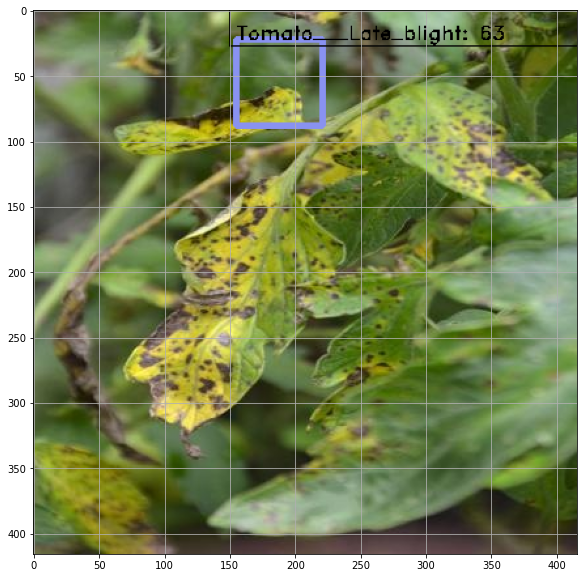

Bacterial_spots563_jpg.rf.941e01bd775713b7966b060e3ce7c765.jpg
Elapsed time = 7.238441705703735
[('Tomato___Late_blight', 74.33441877365112), ('Tomato___Late_blight', 73.98693561553955), ('Tomato___Late_blight', 65.91249704360962), ('Tomato___Late_blight', 65.71773886680603), ('Tomato___Late_blight', 62.84538507461548)]
Actual= Tomato___Bacterial_spot


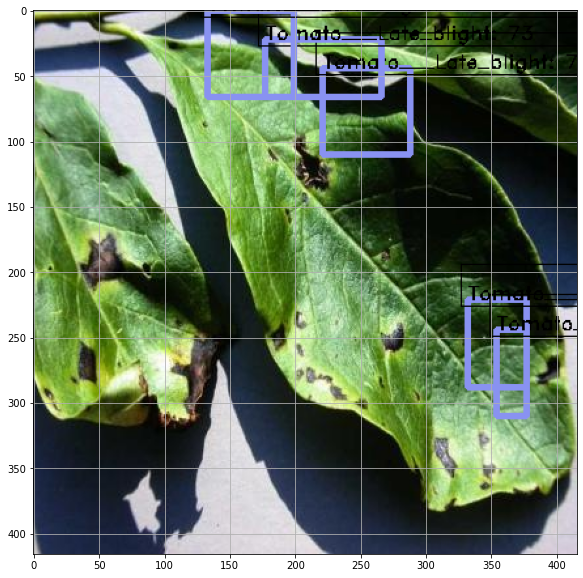

tmv-tomato-34_jpg.rf.a990055f9ae18d7a57319cfbf5851b5a.jpg
Elapsed time = 7.337329387664795
[('Tomato___Late_blight', 93.1941032409668), ('Tomato___Late_blight', 87.5844657421112), ('Tomato___Late_blight', 77.74378657341003), ('Tomato___Late_blight', 77.70400643348694), ('Tomato___Late_blight', 75.02681016921997), ('Tomato___Late_blight', 74.29812550544739), ('Tomato___Late_blight', 70.98451256752014), ('Tomato___Late_blight', 65.98769426345825), ('Tomato___Late_blight', 60.21530032157898)]
Actual= Tomato___Tomato_mosaic_virus


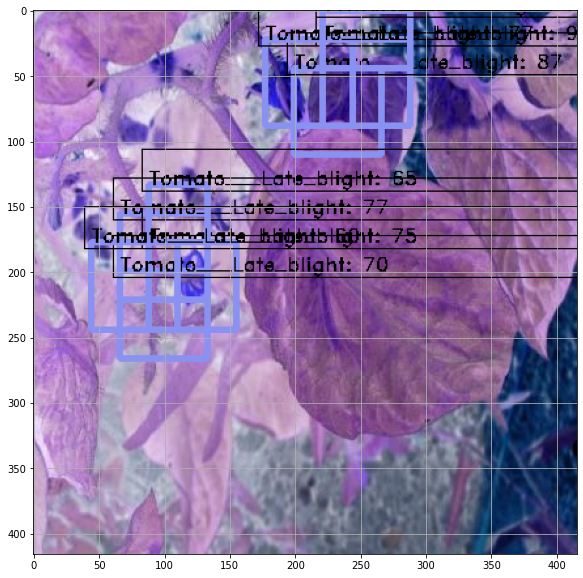

50%20Leafmold%20Top_jpg.rf.29a941a9c4a999749afc0a94a90b71dd.jpg
Elapsed time = 7.358125686645508
[('Tomato___Yellow_Leaf_Curl_Virus', 80.22680878639221), ('Tomato___Tomato_mosaic_virus', 61.01139783859253)]
Actual= Tomato___Leaf_Mold


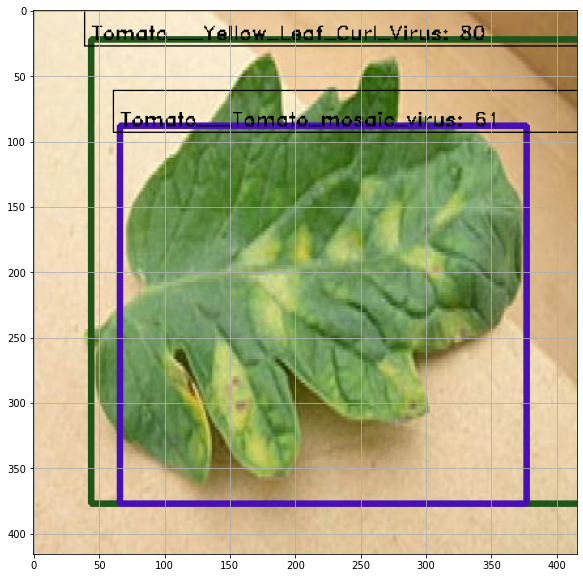

RARZ4_jpg.rf.db9905aaa2c5b655d33c34b4adb0029c.jpg
Elapsed time = 7.258375883102417
[]
Actual= Tomato___Septoria_leaf_spot


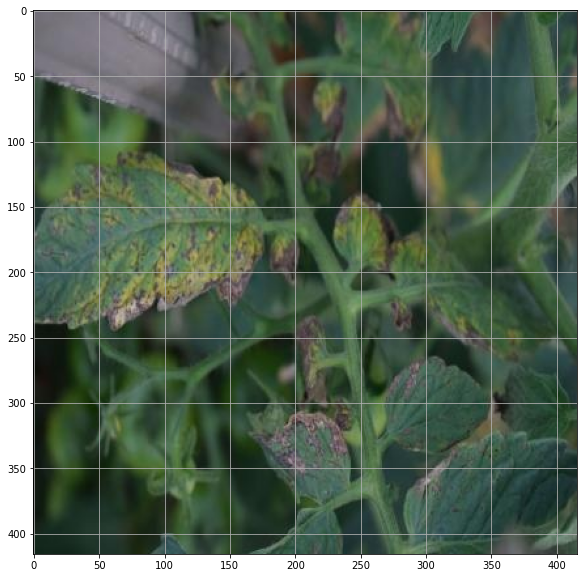

early_blight1-150x150_jpg.rf.de59d2c4b3933b1bb0330da85856c31b.jpg
Elapsed time = 7.275425434112549
[]
Actual= Tomato___Early_blight


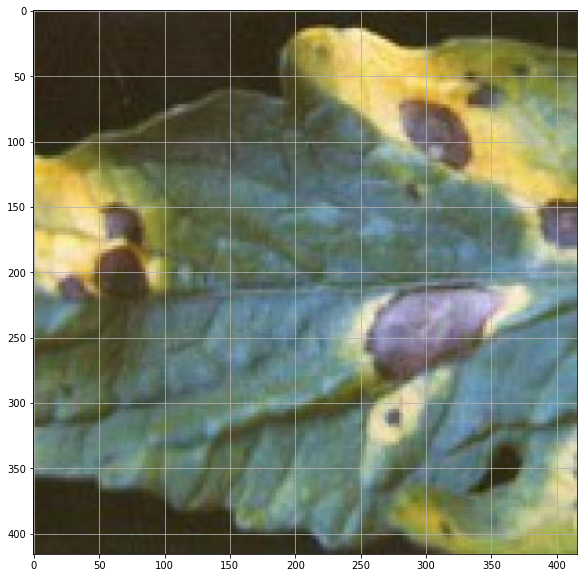

Tomato-Mosaic-1wdr2jx-300x225_jpg.rf.f0e2325f6e421e8b4717e67cd9dbe5a7.jpg
Elapsed time = 7.245465517044067
[]
Actual= Tomato___Tomato_mosaic_virus


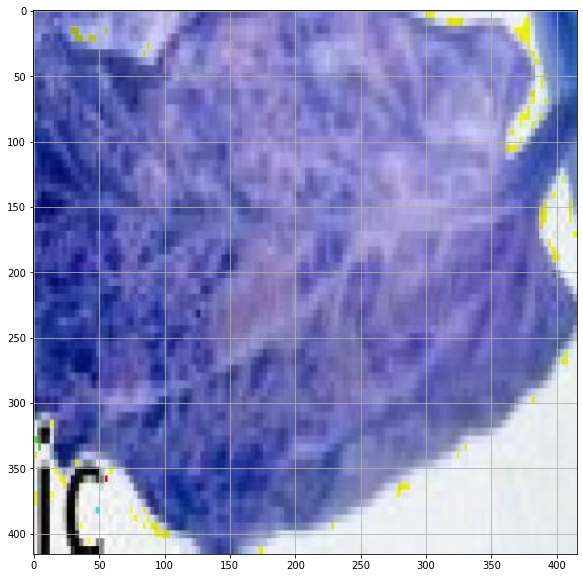

2013-08-20-06_jpg.rf.1622abc448da80aaaf7c5695401b50ea.jpg
Elapsed time = 7.261414051055908
[('Tomato___Target_Spot', 74.92339015007019)]
Actual= Tomato___healthy


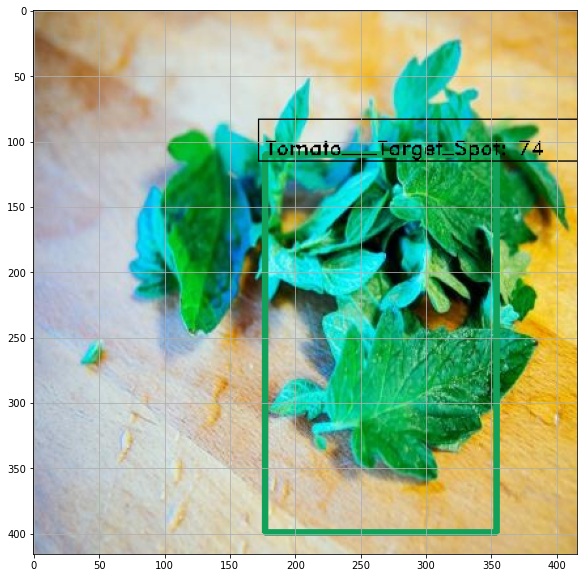

100983448_jpg.rf.bed4a415a191a9b18950dbe1f488a2bb.jpg
Elapsed time = 7.314540386199951
[('Tomato___Yellow_Leaf_Curl_Virus', 94.56185698509216), ('Tomato___Bacterial_spot', 69.89829540252686)]
Actual= Tomato___Early_blight


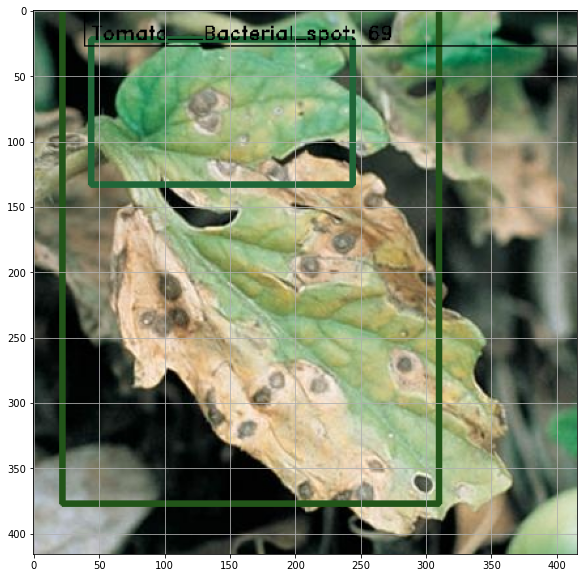

late_blight_tomato_leaf_spore1x1200_jpg.rf.468d0f72d833b2cabeae673927d966eb.jpg
Elapsed time = 7.399864912033081
[('Tomato___Yellow_Leaf_Curl_Virus', 90.97127914428711), ('Tomato___Yellow_Leaf_Curl_Virus', 62.8997802734375), ('Tomato___Yellow_Leaf_Curl_Virus', 62.82393932342529), ('Tomato___Tomato_mosaic_virus', 62.5879168510437)]
Actual= Tomato___Late_blight


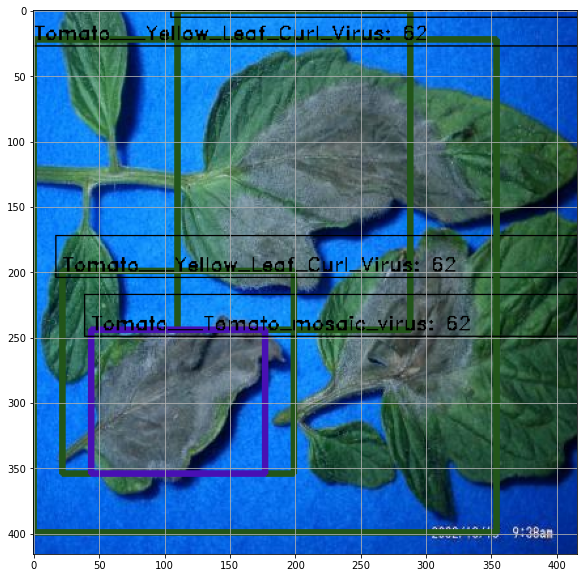

11-40580_5_jpg.rf.48758cb9de89e21d815c527e41624e9c.jpg
Elapsed time = 7.306248188018799
[('Tomato___Late_blight', 96.7081606388092), ('Tomato___Late_blight', 94.31477785110474), ('Tomato___Late_blight', 93.78055930137634), ('Tomato___Late_blight', 90.24343490600586), ('Tomato___Late_blight', 87.81511187553406), ('Tomato___Late_blight', 87.77952194213867), ('Tomato___Late_blight', 86.4924967288971), ('Tomato___Late_blight', 85.64524054527283), ('Tomato___Late_blight', 85.43489575386047), ('Tomato___Late_blight', 84.04349088668823), ('Tomato___Late_blight', 83.73305797576904), ('Tomato___Late_blight', 83.60430002212524), ('Tomato___Late_blight', 83.56528282165527), ('Tomato___Late_blight', 81.8962812423706), ('Tomato___Late_blight', 80.01716136932373), ('Tomato___Late_blight', 79.09148335456848), ('Tomato___Late_blight', 78.34006547927856), ('Tomato___Late_blight', 77.47445106506348), ('Tomato___Late_blight', 74.18375611305237), ('Tomato___Late_blight', 73.42748641967773), ('Tomato___Lat

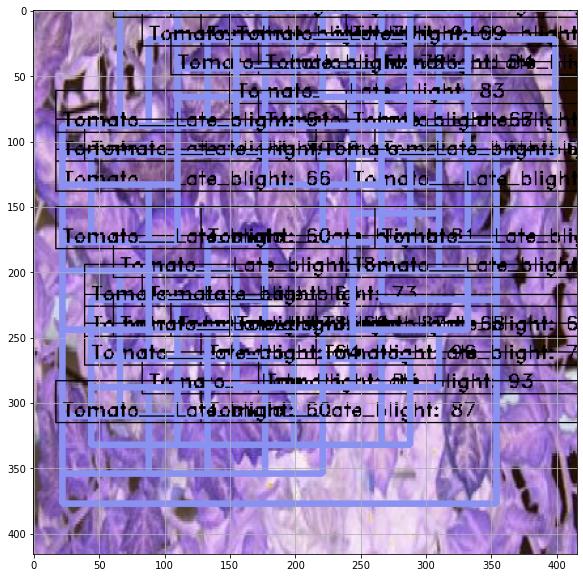

glyphosate_jpg.rf.01dea2d24a1e3591855a68e077bb625e.jpg
Elapsed time = 7.352126121520996
[('Tomato___Late_blight', 98.102205991745), ('Tomato___Late_blight', 97.87476062774658), ('Tomato___Late_blight', 97.75740504264832), ('Tomato___Late_blight', 94.87804174423218), ('Tomato___Late_blight', 94.72553133964539), ('Tomato___Late_blight', 94.27505135536194), ('Tomato___Late_blight', 92.20075607299805), ('Tomato___Late_blight', 90.41268229484558), ('Tomato___Late_blight', 89.41108584403992), ('Tomato___Late_blight', 87.06942796707153), ('Tomato___Late_blight', 85.99047064781189), ('Tomato___Late_blight', 84.15247201919556), ('Tomato___Late_blight', 82.9477071762085), ('Tomato___Late_blight', 78.38002443313599), ('Tomato___Late_blight', 78.27948927879333), ('Tomato___Late_blight', 76.72566771507263), ('Tomato___Late_blight', 76.05018615722656), ('Tomato___Late_blight', 74.59552884101868), ('Tomato___Late_blight', 69.91901993751526), ('Tomato___Late_blight', 69.91000175476074), ('Tomato___Lat

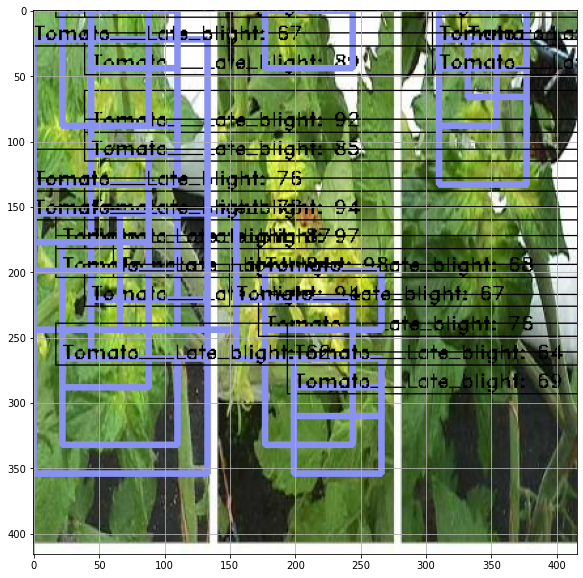

%2320+Bacterial+Spot+and+Speck_jpg.rf.56abfa1b8c07239d7a7b67f36649a105.jpg
Elapsed time = 7.292266368865967
[('Tomato___Bacterial_spot', 73.34444522857666), ('Tomato___Late_blight', 69.5293664932251)]
Actual= Tomato___Bacterial_spot


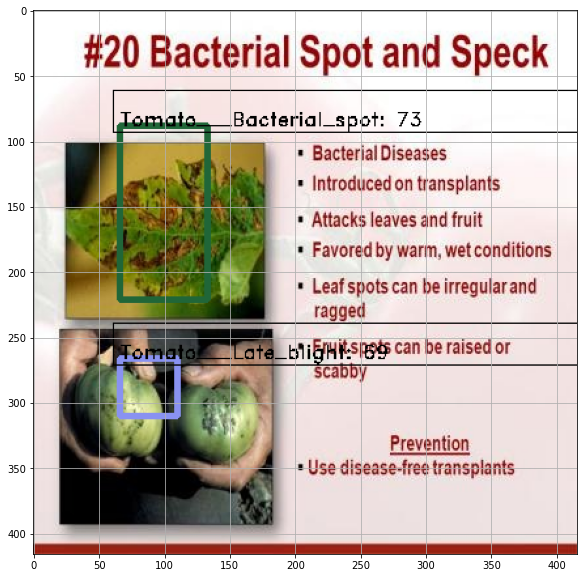

6134794031202304_jpeg_jpg.rf.021531229ad8d669e22e9fa324a1cea8.jpg
Elapsed time = 7.342657804489136
[('Tomato___Late_blight', 99.60171580314636), ('Tomato___Late_blight', 99.33198690414429), ('Tomato___Late_blight', 98.85490536689758), ('Tomato___Late_blight', 95.00454664230347), ('Tomato___Late_blight', 94.49301362037659), ('Tomato___Late_blight', 89.516681432724), ('Tomato___Late_blight', 85.27085185050964), ('Tomato___Late_blight', 72.09259867668152)]
Actual= Tomato___Septoria_leaf_spot


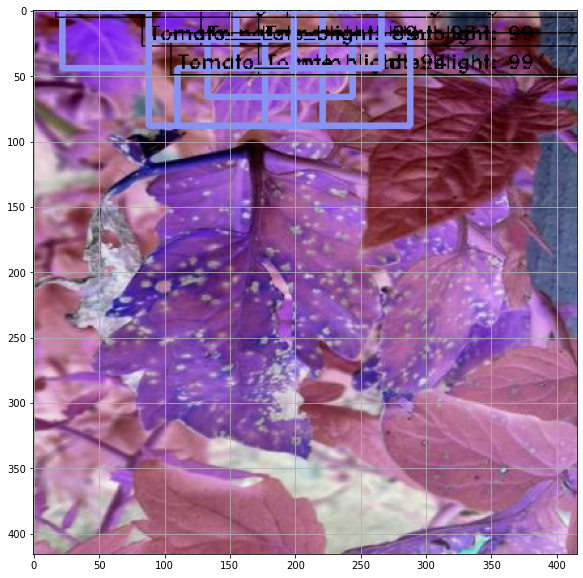

Tom_Bact7_jpg.rf.5c474d23aeb10624844e3bf9df3e4d81.jpg
Elapsed time = 7.469293117523193
[('Tomato___Late_blight', 94.18569207191467), ('Tomato___Late_blight', 92.1862244606018), ('Tomato___Late_blight', 90.99307656288147), ('Tomato___Late_blight', 88.33629488945007), ('Tomato___Late_blight', 77.96100378036499), ('Tomato___Late_blight', 77.87703275680542), ('Tomato___Late_blight', 74.45207834243774), ('Tomato___Late_blight', 71.91980481147766), ('Tomato___Late_blight', 67.80850291252136), ('Tomato___Late_blight', 62.80715465545654), ('Tomato___Late_blight', 62.46674060821533), ('Tomato___Late_blight', 60.32063364982605), ('Tomato___Spider_mites', 67.29410290718079), ('Tomato___Spider_mites', 60.68720817565918)]
Actual= Tomato___Bacterial_spot


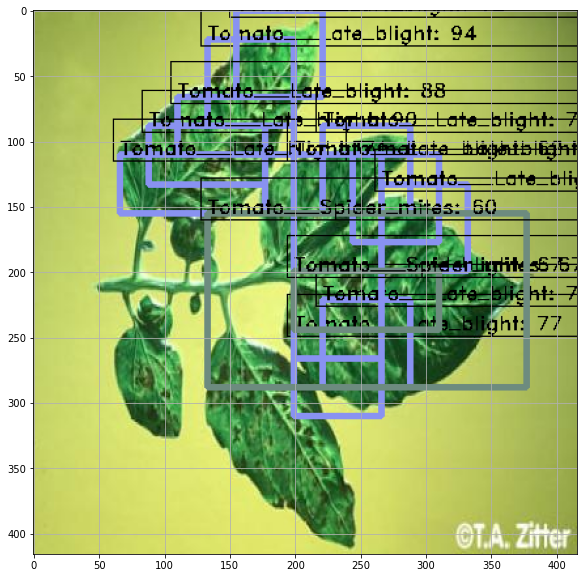

dscn6689_jpg.rf.904696395f42c775453f970be794377d.jpg
Elapsed time = 7.389080286026001
[]
Actual= Tomato___Leaf_Mold


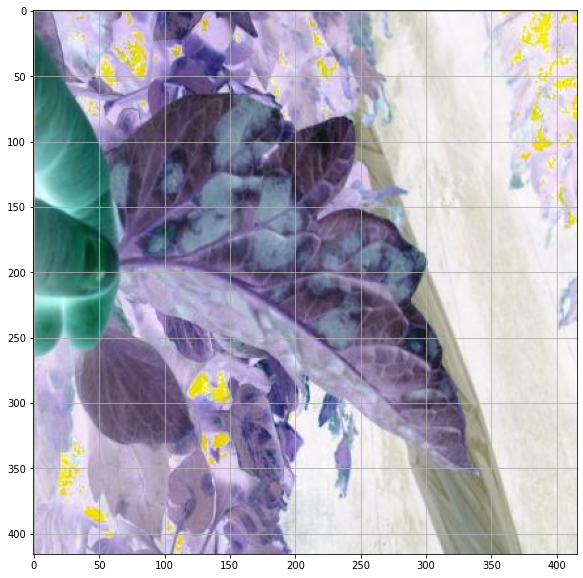

fwa2013313115151_jpg.rf.f46c682f69e0115a10044a45345f437a.jpg
Elapsed time = 7.477544546127319
[('Tomato___Late_blight', 94.05901432037354), ('Tomato___Late_blight', 93.82907152175903), ('Tomato___Late_blight', 93.33975315093994), ('Tomato___Late_blight', 92.72176623344421), ('Tomato___Late_blight', 92.32795834541321), ('Tomato___Late_blight', 92.30820536613464), ('Tomato___Late_blight', 90.91771245002747), ('Tomato___Late_blight', 90.38381576538086), ('Tomato___Late_blight', 90.1840090751648), ('Tomato___Late_blight', 87.92480230331421), ('Tomato___Late_blight', 87.8271222114563), ('Tomato___Late_blight', 87.68265843391418), ('Tomato___Late_blight', 87.26407885551453), ('Tomato___Late_blight', 86.60099506378174), ('Tomato___Late_blight', 86.22168898582458), ('Tomato___Late_blight', 85.2076530456543), ('Tomato___Late_blight', 84.88221764564514), ('Tomato___Late_blight', 84.83258485794067), ('Tomato___Late_blight', 83.47265720367432), ('Tomato___Late_blight', 82.98586010932922), ('Tomato

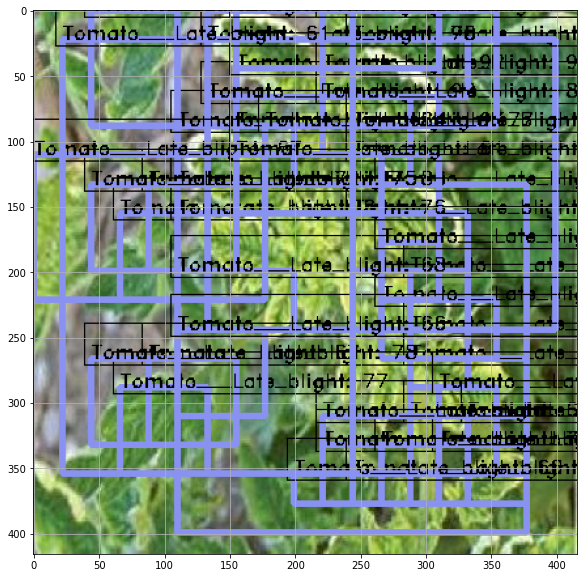

toma_TMV_jpg.rf.fadfed6938fbeef46c39f78a02da3be4.jpg
Elapsed time = 7.421911716461182
[('Tomato___Tomato_mosaic_virus', 82.49243497848511), ('Tomato___Tomato_mosaic_virus', 67.44059324264526)]
Actual= Tomato___Tomato_mosaic_virus


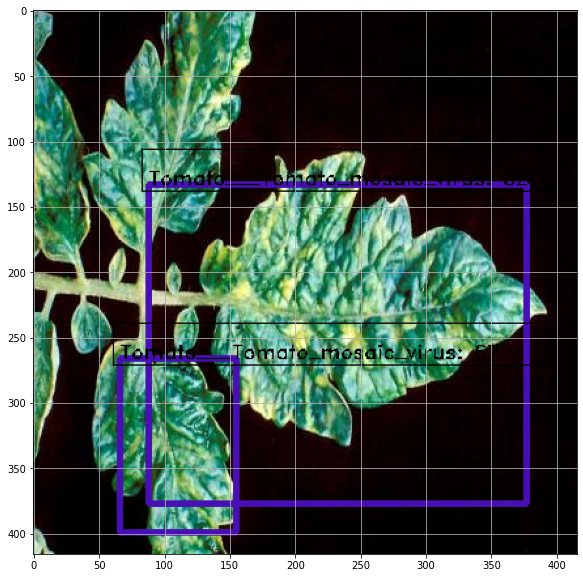

everystockphoto-21099455-l_jpg.rf.ab9c1c8fd47e1d9bf2299279811625aa.jpg
Elapsed time = 7.5215606689453125
[('Tomato___Spider_mites', 88.66305947303772), ('Tomato___Spider_mites', 74.32247996330261), ('Tomato___Late_blight', 96.17705345153809), ('Tomato___Late_blight', 92.95309782028198), ('Tomato___Late_blight', 91.05958342552185), ('Tomato___Late_blight', 81.39861822128296), ('Tomato___Late_blight', 77.01562643051147), ('Tomato___Late_blight', 74.35997724533081), ('Tomato___Late_blight', 72.74631857872009), ('Tomato___Late_blight', 71.46732211112976), ('Tomato___Late_blight', 68.51885318756104), ('Tomato___Late_blight', 68.30791234970093), ('Tomato___Late_blight', 65.4064953327179), ('Tomato___Late_blight', 64.90134596824646), ('Tomato___Late_blight', 63.73213529586792), ('Tomato___Late_blight', 60.77900528907776)]
Actual= Tomato___Tomato_mosaic_virus


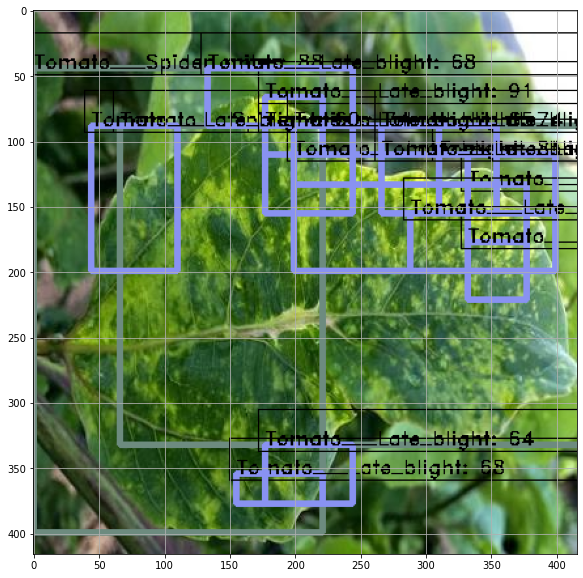

DSCN1015_JPG_jpg.rf.d635e95673d785ba432ba733d31f866c.jpg
Elapsed time = 7.520136117935181
[('Tomato___Late_blight', 86.44596934318542), ('Tomato___Late_blight', 84.48598384857178), ('Tomato___Late_blight', 76.58023238182068), ('Tomato___Late_blight', 70.8146333694458), ('Tomato___Late_blight', 67.38949418067932), ('Tomato___Late_blight', 66.2235975265503), ('Tomato___Late_blight', 66.14308953285217), ('Tomato___Late_blight', 63.42819929122925), ('Tomato___Late_blight', 61.7215096950531), ('Tomato___Late_blight', 61.65156960487366), ('Tomato___Late_blight', 61.27864718437195)]
Actual= Tomato___healthy


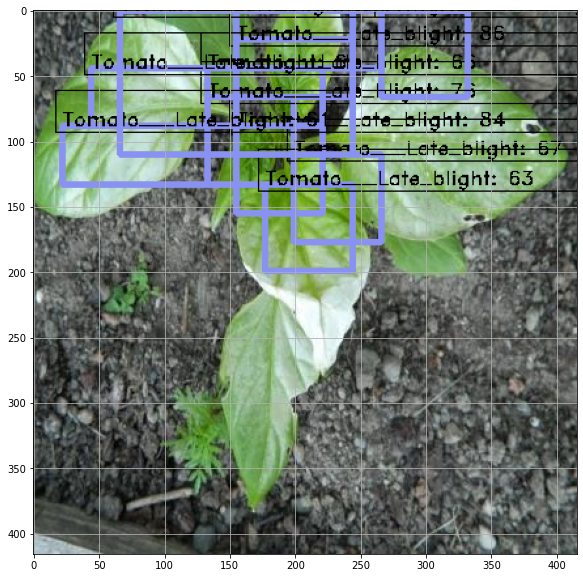

sept4disease-019_jpg.rf.7d5a1ac7d63b933fb38cb6ab2aa22f38.jpg
Elapsed time = 7.4590067863464355
[('Tomato___Late_blight', 65.20194411277771), ('Tomato___Late_blight', 60.15031933784485)]
Actual= Tomato___Septoria_leaf_spot


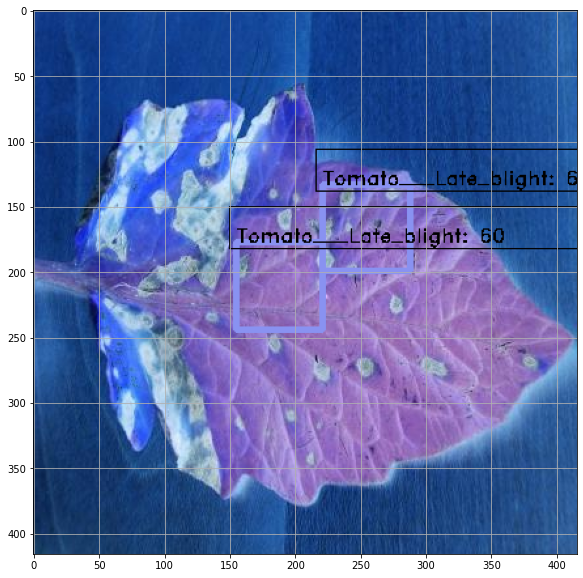

49%20Leafmold%20Bottom_jpg.rf.78084a16d52c337f182bc23d8829955f.jpg
Elapsed time = 7.4314892292022705
[('Tomato___Bacterial_spot', 75.77255964279175)]
Actual= Tomato___Leaf_Mold


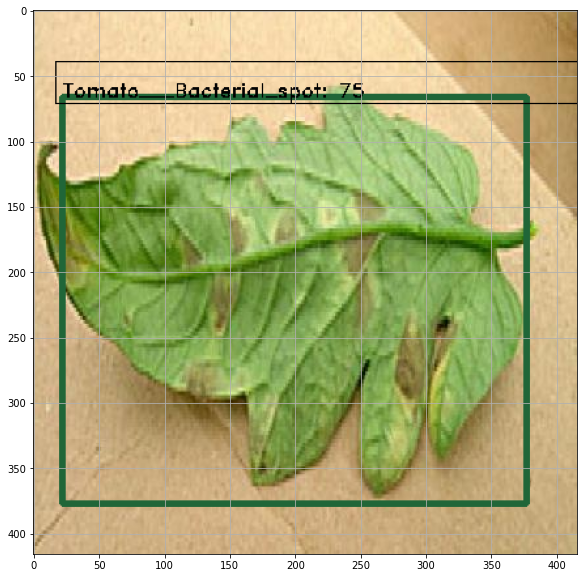

636368370164094909-late-blight-15-_jpg.rf.febe577ab65e7a68b852e375e8d27aac.jpg
Elapsed time = 7.43716287612915
[('Tomato___Yellow_Leaf_Curl_Virus', 60.64991354942322)]
Actual= Tomato___Late_blight


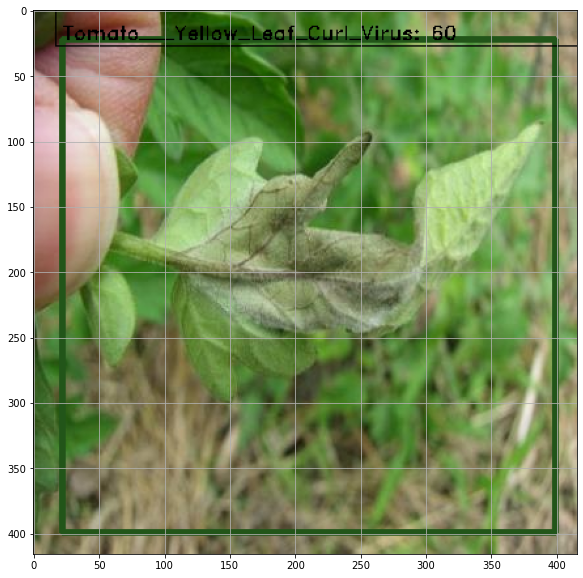

IMG_1246_jpg.rf.eca018e1fb18a786d85761266617e2d0.jpg
Elapsed time = 7.423518896102905
[]
Actual= Tomato___healthy


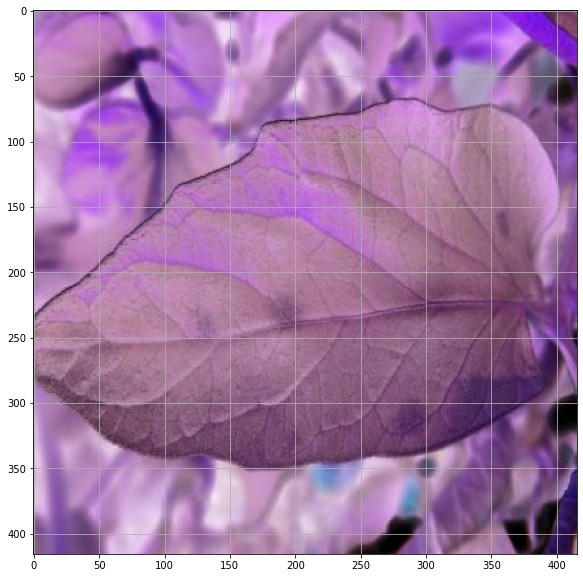

7-17-Photo3_Septoria-MARY_jpg.rf.0455b67b7744a20bafd46c20e0c0c19a.jpg
Elapsed time = 7.398158073425293
[('Tomato___Target_Spot', 98.05163741111755)]
Actual= Tomato___Septoria_leaf_spot


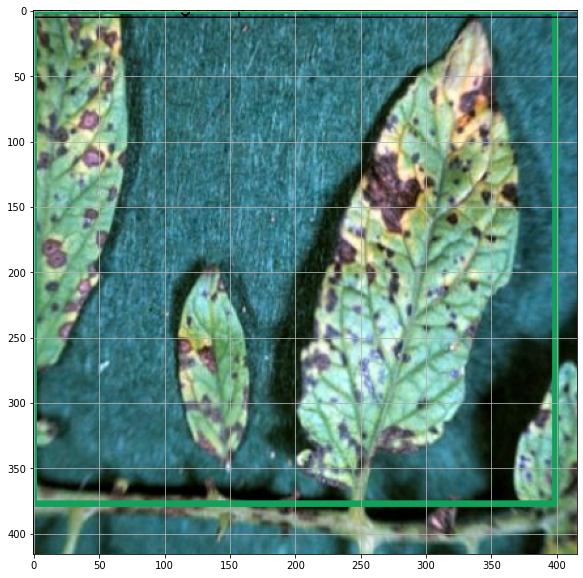

9511_img_jpg.rf.2b2a1dce2226ac7182876af33c2889e1.jpg
Elapsed time = 7.469640731811523
[('Tomato___Late_blight', 91.15560054779053), ('Tomato___Late_blight', 84.60867404937744), ('Tomato___Late_blight', 82.00256824493408), ('Tomato___Late_blight', 81.64362907409668), ('Tomato___Late_blight', 80.28650879859924), ('Tomato___Late_blight', 79.45206761360168), ('Tomato___Late_blight', 77.7815043926239), ('Tomato___Late_blight', 76.62087082862854), ('Tomato___Late_blight', 76.4020025730133), ('Tomato___Late_blight', 70.14668583869934), ('Tomato___Late_blight', 70.10367512702942), ('Tomato___Late_blight', 67.74090528488159), ('Tomato___Late_blight', 65.44082760810852), ('Tomato___Late_blight', 64.04992938041687), ('Tomato___Late_blight', 61.49577498435974)]
Actual= Tomato___Tomato_mosaic_virus


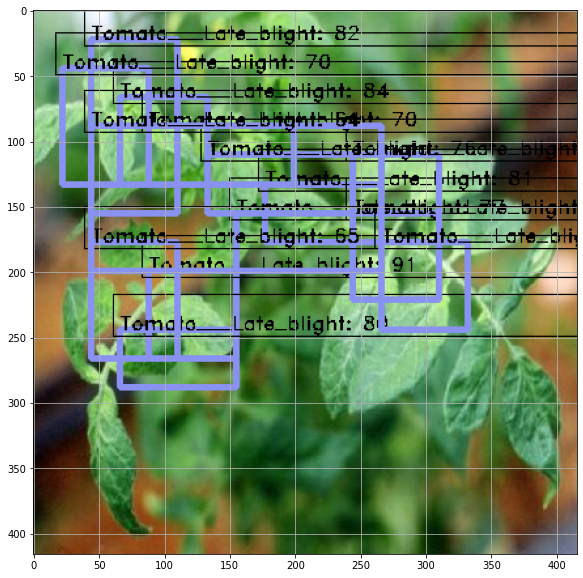

07_17_18-Common_Tomato_Diseases_Canker-258x300_jpg.rf.89b382e5825ed43f6d3aeb24602b5c22.jpg
Elapsed time = 7.578074932098389
[]
Actual= Tomato___Bacterial_spot


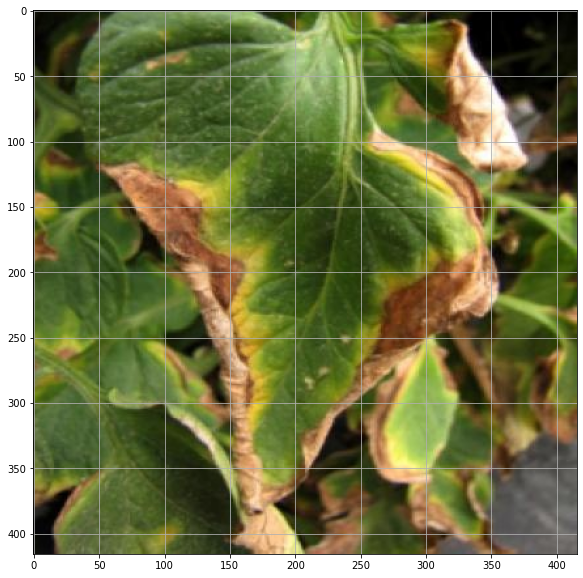

D%29AlfMov_jpg.rf.f56360becd23fe1038f5c4ccfdcda690.jpg
Elapsed time = 7.425248384475708
[]
Actual= Tomato___Tomato_mosaic_virus


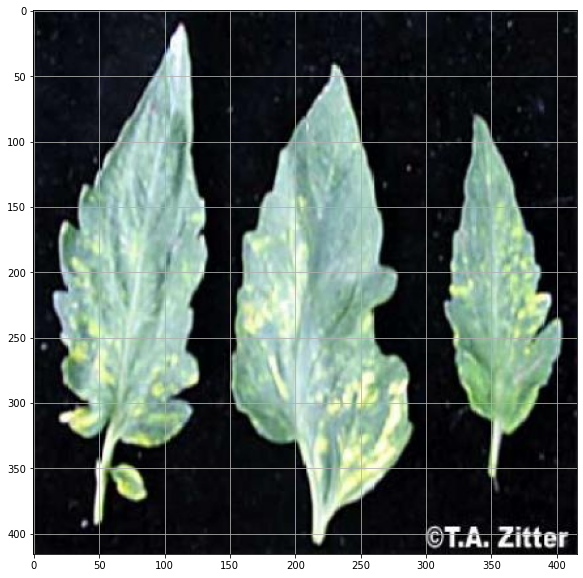

110822-206-Tomato-blight_jpg.rf.d5d4f6bcae0b086dd1903efeb155153a.jpg
Elapsed time = 7.547741174697876
[('Tomato___Yellow_Leaf_Curl_Virus', 99.42374229431152)]
Actual= Tomato___Late_blight


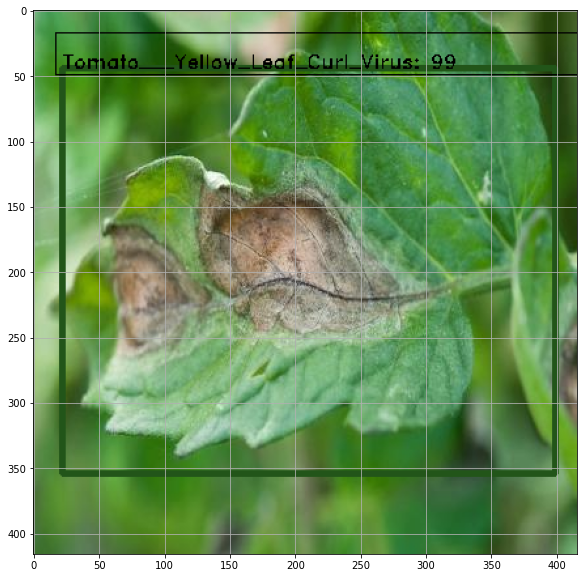

90e2c0_jpg.rf.4c2c2d1249f24703193ffb3b28c5a0f6.jpg
Elapsed time = 7.502965450286865
[('Tomato___Tomato_mosaic_virus', 72.30378985404968)]
Actual= Tomato___healthy


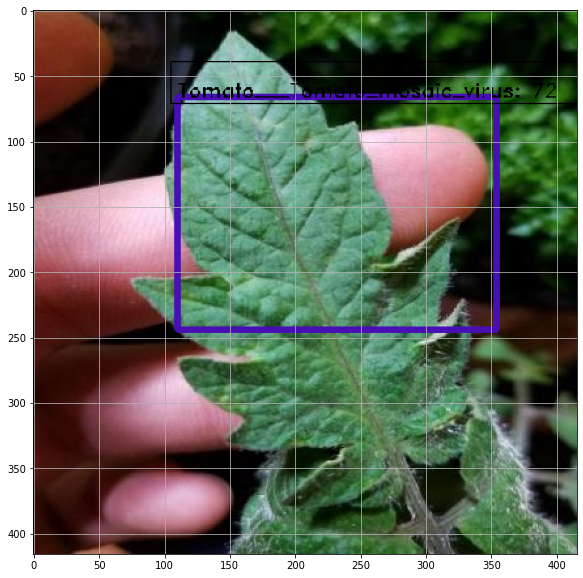

8226402877_9abf151b5b_b_jpg.rf.56250ae6fbcad408c84ee041014e3239.jpg
Elapsed time = 7.669848442077637
[('Tomato___Late_blight', 99.03209805488586), ('Tomato___Late_blight', 98.95240664482117), ('Tomato___Late_blight', 98.82712960243225), ('Tomato___Late_blight', 98.2821524143219), ('Tomato___Late_blight', 98.05442690849304), ('Tomato___Late_blight', 97.99166917800903), ('Tomato___Late_blight', 97.1639633178711), ('Tomato___Late_blight', 96.89610600471497), ('Tomato___Late_blight', 96.87373042106628), ('Tomato___Late_blight', 95.15172839164734), ('Tomato___Late_blight', 94.05050277709961), ('Tomato___Late_blight', 93.69871616363525), ('Tomato___Late_blight', 93.046635389328), ('Tomato___Late_blight', 93.01868081092834), ('Tomato___Late_blight', 91.65140986442566), ('Tomato___Late_blight', 90.84129929542542), ('Tomato___Late_blight', 90.75989723205566), ('Tomato___Late_blight', 90.74209928512573), ('Tomato___Late_blight', 90.08285999298096), ('Tomato___Late_blight', 89.85174894332886), ('

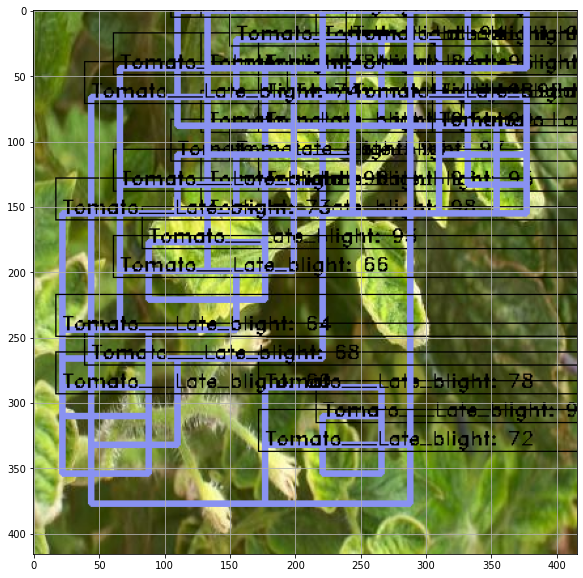

main-qimg-d9c2a93f60568485c989670d9bbf703b_jpg.rf.b0d8753adb30886568981e9e33b35ed6.jpg
Elapsed time = 7.682091951370239
[('Tomato___Early_blight', 66.13961458206177), ('Tomato___Late_blight', 63.93595337867737), ('Tomato___Late_blight', 62.42075562477112), ('Tomato___Late_blight', 60.30203104019165)]
Actual= Tomato___healthy


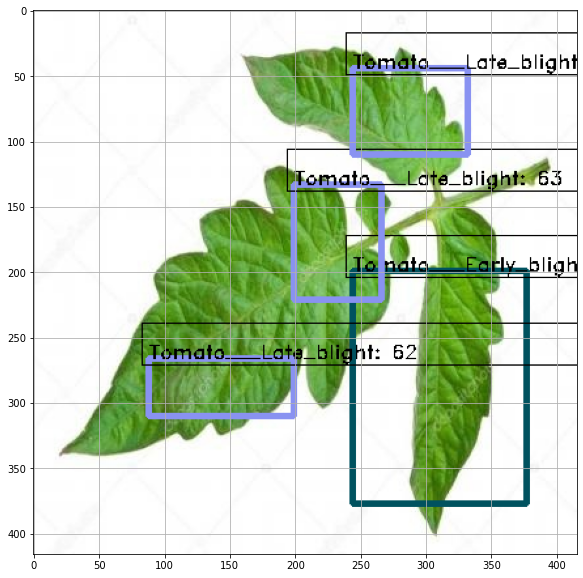

earlyblight21__jpg.rf.1d59d01997d3c54faaddc88ce60c2f00.jpg
Elapsed time = 7.596205234527588
[('Tomato___Late_blight', 86.67023777961731), ('Tomato___Late_blight', 70.50520777702332), ('Tomato___Late_blight', 68.69144439697266), ('Tomato___Late_blight', 60.66961884498596), ('Tomato___Late_blight', 60.532134771347046)]
Actual= Tomato___Early_blight


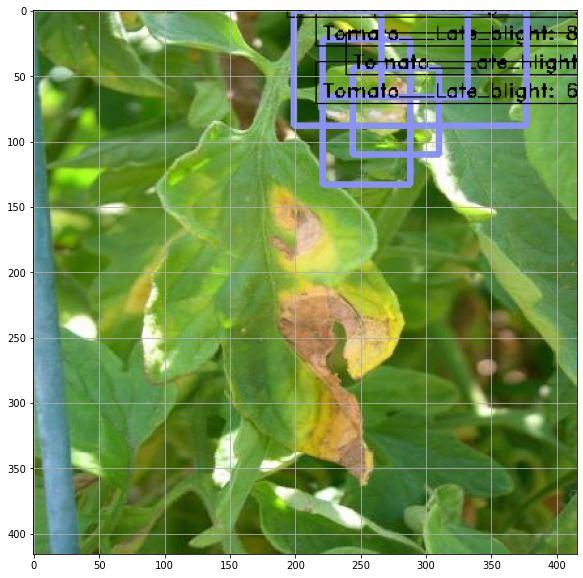

LateBlt09_06_jpg.rf.64e7ff8ffa73fabfdd8f35f12b80db52.jpg
Elapsed time = 7.555874586105347
[]
Actual= Tomato___Late_blight


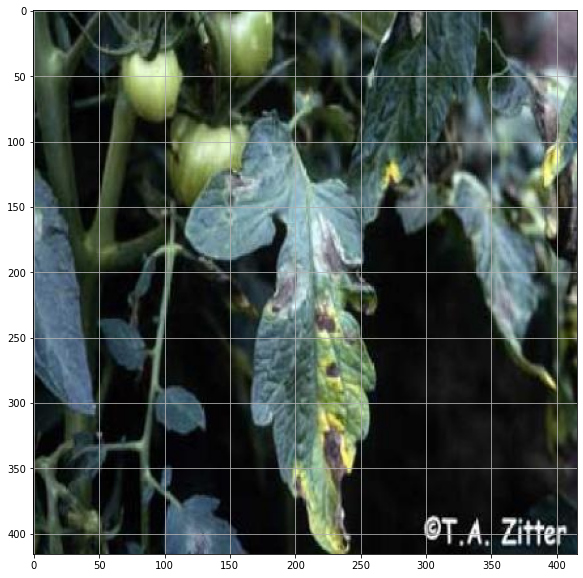

636227737977191231-septoria-leaf-spot-VT_jpg.rf.d06820dfad4e145270ddf84fd927ee98.jpg
Elapsed time = 7.517113924026489
[('Tomato___Late_blight', 81.79961442947388), ('Tomato___Late_blight', 65.92668890953064)]
Actual= Tomato___Septoria_leaf_spot


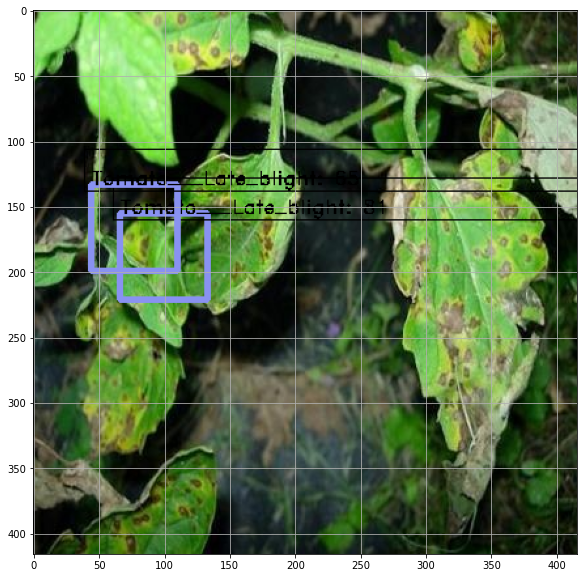

tylcv-seminar-1-638_jpg.rf.b36cb3ce3357d4d9f3f52f4ec910a1dc.jpg
Elapsed time = 7.648768186569214
[('Tomato___Late_blight', 99.51554536819458), ('Tomato___Late_blight', 99.24551248550415), ('Tomato___Late_blight', 98.96021485328674), ('Tomato___Late_blight', 98.90168905258179), ('Tomato___Late_blight', 98.43548536300659), ('Tomato___Late_blight', 98.27704429626465), ('Tomato___Late_blight', 98.1732964515686), ('Tomato___Late_blight', 98.13249707221985), ('Tomato___Late_blight', 97.80620336532593), ('Tomato___Late_blight', 96.35847210884094), ('Tomato___Late_blight', 95.71633338928223), ('Tomato___Late_blight', 94.88810896873474), ('Tomato___Late_blight', 94.76492404937744), ('Tomato___Late_blight', 94.11514401435852), ('Tomato___Late_blight', 93.29973459243774), ('Tomato___Late_blight', 92.97891855239868), ('Tomato___Late_blight', 92.46359467506409), ('Tomato___Late_blight', 91.30849242210388), ('Tomato___Late_blight', 88.1588876247406), ('Tomato___Late_blight', 87.69676089286804), ('To

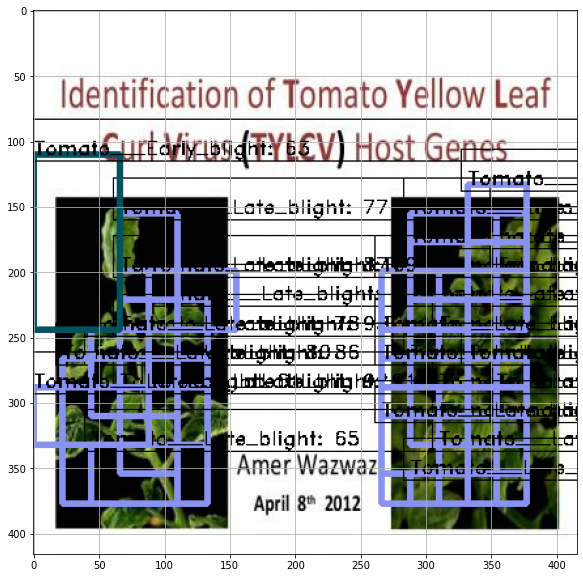

Tomato%2BBacterial%2BSpot%2Bon%2BLeaves_jpg.rf.deaa5a5ee56e740386664bed2d8c5194.jpg
Elapsed time = 7.663116216659546
[('Tomato___Late_blight', 62.91695237159729)]
Actual= Tomato___Bacterial_spot


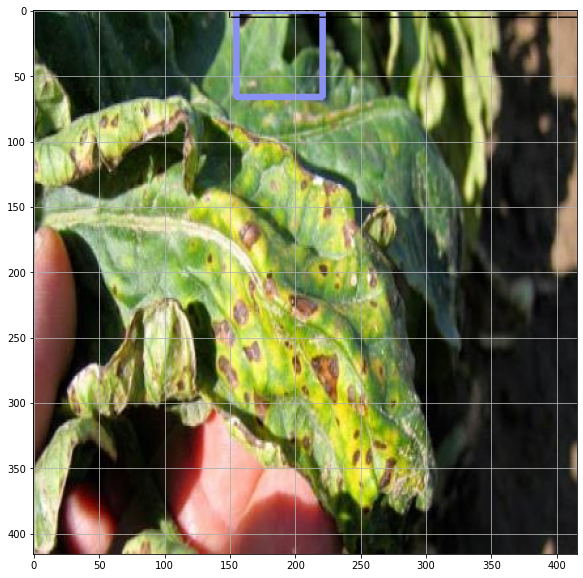

tomato_virus_04_zoom_jpg.rf.15a8f4a043d454af54d5854675d4e6fa.jpg
Elapsed time = 7.626401424407959
[('Tomato___Late_blight', 88.36602568626404), ('Tomato___Late_blight', 71.14139795303345), ('Tomato___Late_blight', 61.24235391616821)]
Actual= Tomato___Tomato_mosaic_virus


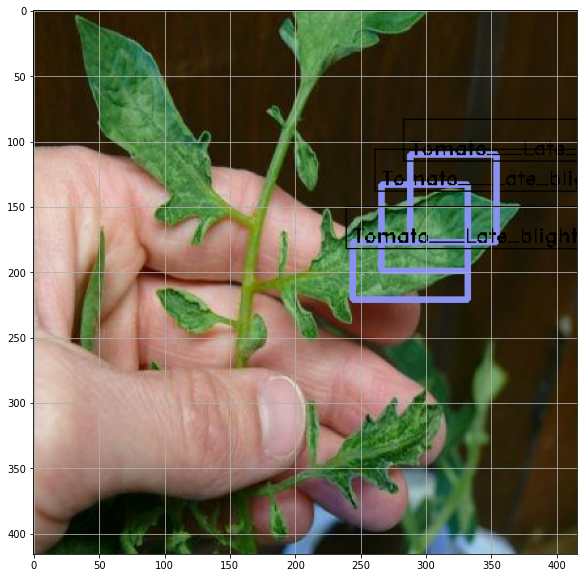

E%29Tomato-late-blight-foliar_jpg.rf.72e5e7700d62b2b53b9c77fec7b9eb20.jpg
Elapsed time = 7.58460807800293
[('Tomato___Yellow_Leaf_Curl_Virus', 97.80820608139038)]
Actual= Tomato___Late_blight


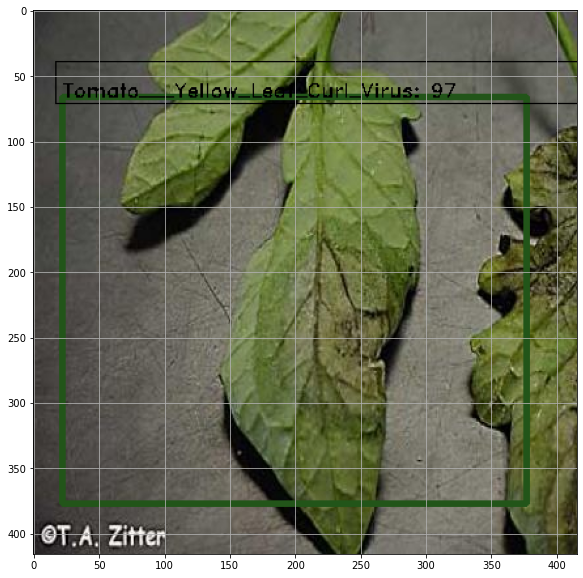

dsc_8148cs_jpg.rf.50aa6552af153a8d793e47580f3e253b.jpg
Elapsed time = 7.605465650558472
[('Tomato___Late_blight', 73.34842681884766), ('Tomato___Late_blight', 72.22833037376404), ('Tomato___Late_blight', 70.40948867797852), ('Tomato___Late_blight', 68.80464553833008), ('Tomato___Late_blight', 65.60607552528381), ('Tomato___Late_blight', 65.22752046585083), ('Tomato___Late_blight', 63.438791036605835), ('Tomato___Late_blight', 60.71392893791199), ('Tomato___Late_blight', 60.432833433151245)]
Actual= Tomato___Late_blight


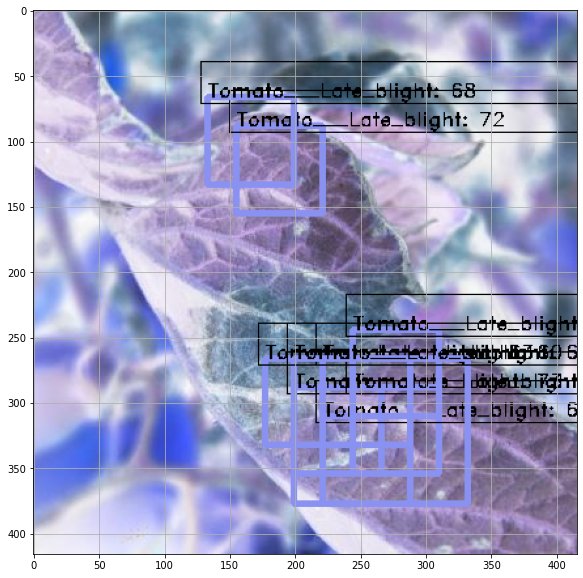

bugs-and-blight-061_jpg.rf.6df53faa42d69a53cc52c5ca8b1bd023.jpg
Elapsed time = 7.641114711761475
[('Tomato___Late_blight', 96.06956243515015), ('Tomato___Late_blight', 94.4782555103302), ('Tomato___Late_blight', 93.55204701423645), ('Tomato___Late_blight', 92.98846125602722), ('Tomato___Late_blight', 92.1290397644043), ('Tomato___Late_blight', 90.9835696220398), ('Tomato___Late_blight', 90.73458313941956), ('Tomato___Late_blight', 88.63223195075989), ('Tomato___Late_blight', 87.8743052482605), ('Tomato___Late_blight', 87.00922131538391), ('Tomato___Late_blight', 86.86673641204834), ('Tomato___Late_blight', 84.18852686882019), ('Tomato___Late_blight', 83.20926427841187), ('Tomato___Late_blight', 81.76355361938477), ('Tomato___Late_blight', 81.43945336341858), ('Tomato___Late_blight', 78.52472066879272), ('Tomato___Late_blight', 77.99714207649231), ('Tomato___Late_blight', 76.91944241523743), ('Tomato___Late_blight', 75.98114013671875), ('Tomato___Late_blight', 75.5946159362793), ('Tomat

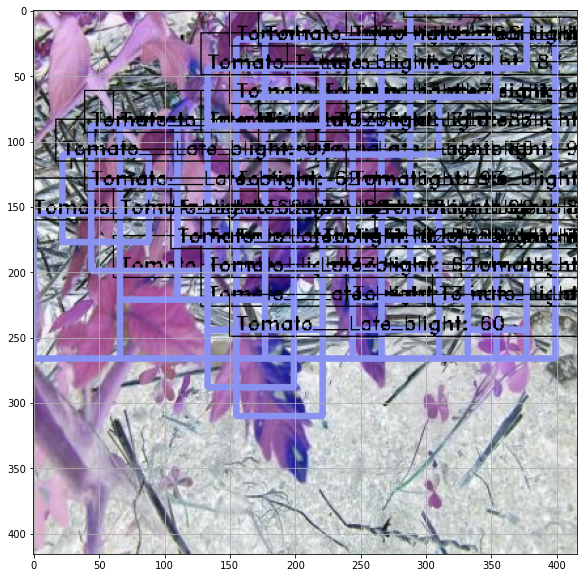

2STEM_jpg.rf.2e39022128cbb552852a72d23a72e6d9.jpg
Elapsed time = 7.63821268081665
[]
Actual= Tomato___Septoria_leaf_spot


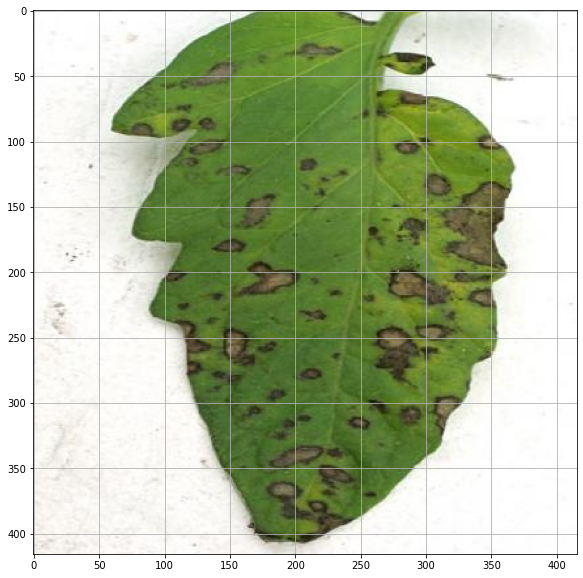

1234080-Early-Blight_jpg.rf.3b70beba5544560151ccafd21a66290f.jpg
Elapsed time = 7.654946565628052
[]
Actual= Tomato___Early_blight


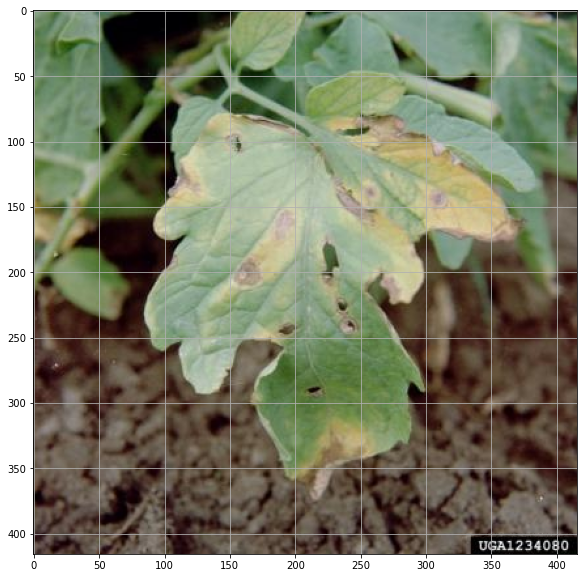

In [65]:
predicted=[]
actual=[]
    # If the box classification value is less than this, we ignore this box
bbox_threshold = 0.6

for idx, img_name in enumerate(imgs_path):
    if not img_name.lower().endswith(('.bmp', '.jpeg', '.jpg', '.png', '.tif', '.tiff')):
        continue
    print(img_name)
    st = time.time()
    filepath = os.path.join(test_base_path, img_name)

    img = cv2.imread(filepath)

    X, ratio = format_img(img, C)
    
    X = np.transpose(X, (0, 2, 3, 1))

    # get output layer Y1, Y2 from the RPN and the feature maps F
    # Y1: y_rpn_cls
    # Y2: y_rpn_regr
    [Y1, Y2, F] = model_rpn.predict(X)

    # Get bboxes by applying NMS 
    # R.shape = (300, 4)
    R = rpn_to_roi(Y1, Y2, C, K.image_data_format(), overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0]//C.num_rois + 1):
        ROIs = np.expand_dims(R[C.num_rois*jk:C.num_rois*(jk+1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0]//C.num_rois:
            #pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0],C.num_rois,curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])
        
        # Calculate bboxes coordinates on resized image
        for ii in range(P_cls.shape[1]):
            # Ignore 'bg' class
            if np.max(P_cls[0, ii, :]) < bbox_threshold or np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                 continue

            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :-1])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4*cls_num:4*(cls_num+1)]
                tx /= C.classifier_regr_std[0]
                ty /= C.classifier_regr_std[1]
                tw /= C.classifier_regr_std[2]
                th /= C.classifier_regr_std[3]
                x, y, w, h = apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([C.rpn_stride*x, C.rpn_stride*y, C.rpn_stride*(x+w), C.rpn_stride*(y+h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])

        new_boxes, new_probs = non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.3)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk,:]

            # Calculate real coordinates on original image
            (real_x1, real_y1, real_x2, real_y2) = get_real_coordinates(ratio, x1, y1, x2, y2)

            cv2.rectangle(img,(real_x1, real_y1), (real_x2, real_y2), (int(class_to_color[key][0]), int(class_to_color[key][1]), int(class_to_color[key][2])),4)

            textLabel = '{}: {}'.format(key,int(100*new_probs[jk]))
            all_dets.append((key,100*new_probs[jk]))

            (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,1,1)
            textOrg = (real_x1, real_y1-0)

            cv2.rectangle(img, (textOrg[0] - 5, textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 1)
            # cv2.rectangle(img, (textOrg[0] - 5,textOrg[1]+baseLine - 5), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
            cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.5, (0, 0, 0), 1)
    
    print('Elapsed time = {}'.format(time.time() - st))
    print(all_dets)
    if all_dets!=[]:
      predicted.append(C.class_mapping[sorted(all_dets,key=lambda x: x[1],reverse=True)[0][0]])
    else:
      predicted.append(10)
    actual.append(C.class_mapping[test_df.loc[test_df.filename==img_name,'class_name'].values[0]])
    print('Actual=',test_df.loc[test_df.filename==img_name,'class_name'].values[0])
    plt.figure(figsize=(10,10))
    plt.grid()
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    plt.show()

    if not os.path.isdir("results"):
      os.mkdir("results")
    cv2.imwrite('./results/{}.png'.format(idx),img)

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(actual,predicted)

In [68]:
len(actual)

69

In [72]:
import numpy as np
npactual=np.array(actual)
nppredicted=np.array(predicted)
arr=(npactual==nppredicted)
arr

array([False,  True, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,  True, False, False, False, False,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,  True, False, False, False])

In [74]:
print("accuracy",np.count_nonzero(arr)/len(arr))

accuracy 0.07246376811594203
